

Per il coach che correggera' questo progetto:

1. Il progetto viene mostrato seguendo la pipeline standard, dall'import alla discussione finale. Ho inserito alcuni capitoli iniziali con delle funzioni costruite da me. Ognuna ha un'accurata documentazione. In particolare:

- (-1): contiene installazioni ed imports necessari;

- (A): contiene la definizione della classe per l'Early Stopping;

- (B): contiene tutto ciò che è necessario per eseguire il training di un modello ed analizzare i risultati. La sottodivisione riguarda funzioni da usare sul train e validation set oppure sul test set. Inoltre durante il training vengono automaticamente salvate tutte le quantità necessarie per visualizzare i plot del training (funzione `training_results`) ed a studiare le metriche successivamente (funzioni `plot_confusion_matrix` e `metrics_report`), in particolare il F1-score (macro);

- (C): contiene una suite completa per la visualizzazione delle immagini, dall'inversione della normalizzazione (funzione `before_preprocessing`), all' esplorazione visiva del dataset (funzione `dataset_inspection`) e delle predizioni (funzione `show_predictions`). Questa suite serve per studiare in dettaglio il dataset ed i risultati del training, per capire dove il modello sbaglio e possibilmente avere un'idea del perche';

- (D): contiene la definizione delle classi per la model explainability, ed in particolare GradCAM e Saliency Map. Questi strumenti sono stati utilizzati nel notebook per cercare di capire se i modelli stanno 'guardando' le features importanti nelle immagini.

2. Ho impostato il notebook in modo estremamente didattico, con spiegazioni dettagliate di ogni passaggio (probabilmente spiegazioni ridondanti, ma meglio abbondare in questo contesto).

3. L'approccio metodologico confronta vari modelli 'backbone' usati come baseline ed anche la data augmentation. Scelto il miglior modello baseline, si procede a cercare una prestazione migliore. **NB** dopo vari tentativi, ho notato che l'optimizer migliore e' Adam. Inoltre, non ho utilizzato K-fold cross-validation (come sarebbe giusto) per motivi di tempo e disponibilita' di risorse di calcolo (nel notebook spieghero' meglio questo punto). Quindi, i parametri migliori (architettura, regolarizzazione, learning rate) sono stati scelti facendo svariate prove con cross-validation standard (cioe' usando dapprima i train-validation sets e solo alla fine il test set).

4. Sono consapevole che le funzioni scritte manualmente da me potrebbero essere rese molto piu' robuste (controlli sugli input, eccetera), ma ho comunque messo documentazione tramite docstring. Per tenere il progetto autoconsistente ma senza esagerare, ho usato definizioni funzionali al contesto e che possono essere riutilizzate in molti altri contesti;

5. Il notebook è stato sviluppato in modo da poter essere rieseguito integralmente dall’inizio senza errori o dipendenze esterne, ed inoltre i risultati sono (il piu' possibile) riproducibili.

6. **Non ho copiato nessun codice**, usando solo la reference ufficiale di PyTorch e Torchvision ove necessario.


Chiedo al coach una valutazione il piu' possibile severa. Se fosse possibile, gradirei sapere la votazione, per poter tenere traccia delle mie skills in futuro.

# (-1) Imports, reproducibility and device setting

In [ ]:
!pip install torchinfo timm

# basic imports
import os

import numpy as np
import pandas as pd
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns
import torch

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, precision_score, recall_score
from sklearn.model_selection import KFold

import torch.nn as nn
import torch.utils.data as data_utils
import torchvision
import torchvision.transforms as T
import albumentations as A
from albumentations.pytorch import ToTensorV2

# utils
from tqdm import tqdm
from IPython.display import display
from torchinfo import summary

In [ ]:
from torch.amp import autocast, GradScaler

cuda_available = torch.cuda.is_available()
scaler = GradScaler(enabled = cuda_available)

device = torch.device("cuda" if cuda_available else "cpu")

In [ ]:
import random
seed = 156
np.random.seed(seed)
random.seed(seed)
torch.manual_seed(seed);

if cuda_available:
    torch.cuda.manual_seed_all(seed)

# (A) Early Stopping Class

In [ ]:
class EarlyStopping:
  def __init__(self, mode = "d", patience = 5, delta = 0, verbose = False, path = 'checkpoint.pt'):
    """
    mode: use "d" (default) for a metric that must be minimized, "c" otherwise
    patience: Number of epochs to wait for improvement: after
             'patient number of epochs' without improvement, training will stop
    delta: if the validation metric does not improve by at least 'delta' > 0,
           it is not considered an improvement.
    verbose: if True, print a message when validation metric does not improve
    path: path to save the model checkpoint

    """
    self.patience = patience
    self.delta = delta
    self.verbose = verbose
    self.path = path
    self.counter = 0 # counter to track epochs without improvement
    self.best_score = None
    self.early_stop = False # bool to indicate whether to stop training
    self.mode = mode

  def save_checkpoint(self, model):
    os.makedirs(os.path.dirname(self.path), exist_ok = True)
    torch.save(model.state_dict(), self.path)

  def __call__(self, val_metric, model):
    if self.best_score is None:
      self.best_score = val_metric
      self.save_checkpoint(model)

    elif (self.mode == "d" and val_metric < self.best_score - self.delta) or \
          (self.mode == "c" and val_metric > self.best_score + self.delta):
        self.best_score = val_metric
        self.save_checkpoint(model)
        self.counter = 0

    else:
      self.counter += 1
      if self.verbose:
        print(f'Epochs without improvement: {self.counter}')
      if self.counter >= self.patience:
                self.early_stop = True

# (B) Classification Utilities

## Training and Validation Utilities

### train_classification

In [ ]:
def train_classification(model, loss_fn, optimizer, train_loader, val_loader, scheduler = None, epochs = 1,
                         verbose = False, confusion_matrix_data = False, early_stopping = None):
  """
  model: a model object from the class torch.nn.Module of PyTorch;
  loss_fn: a loss function. Example: loss_fn = torch.nn.CrossEntropyLoss();
  optimizer: an object of the class torch.optim. Example: optimizer = torch.optim.SGD();
  train_loader and val_loader: train and validation loader from the class torch.utils.data.DataLoader;
  scheduler: an object from torch.optim.lr_scheduler. Example: scheduler = torch.optim.lr_scheduler.StepLR(optimizer).
             Default is scheduler = None;
  epochs: number of training epochs. Default is epochs = 1;
  verbose: if True, it prints at each epoch train and validation losses and accuracies;
  confusion_matrix_data: if False, the function returns a list of lists with
                                   train_losses, train_accuracies, val_losses, val_accuracies
                                   for each epoch;
                         if True, the function returns also a list of lists with
                                   all_y_train, all_yhat_train, all_y_val, all_yhat_val
                                   that can be used to show the confusion matrix later;
  early_stopping: an object of the class EarlyStopping. Default is early_stopping = None.
  """

  train_losses, val_losses, train_accuracies, val_accuracies = [], [], [], []
  all_y_train, all_yhat_train, all_y_val, all_yhat_val = [], [], [], []

  for epoch in tqdm(range(1, epochs + 1)):
    train_loss_of_batches, train_correct_predictions_of_batches = 0.0, 0.0
    val_loss_of_batches, val_correct_predictions_of_batches = 0.0, 0.0

    #################### training part ####################

    model.train()
    total_number_of_examples = 0
    for X_train, y_train in train_loader:
      batch_size = y_train.shape[0]
      total_number_of_examples += batch_size
      X_train, y_train = X_train.to(device), y_train.to(device)
      with autocast(device_type = device.type, dtype = torch.float16, enabled = cuda_available):
        logitshat_train = model(X_train)
        train_loss_of_batch = loss_fn(logitshat_train, y_train)
      optimizer.zero_grad()
      scaler.scale(train_loss_of_batch).backward()
      scaler.step(optimizer)
      scaler.update()
      train_loss_of_batches += train_loss_of_batch.item() * batch_size

      with torch.no_grad():
        yhat_train = torch.argmax(logitshat_train, dim = 1)
        train_correct_prediction_of_batch = (yhat_train == y_train).sum().item()
        train_correct_predictions_of_batches += train_correct_prediction_of_batch

    # it is useful normalize the loss, only for comparing purposes
    train_losses.append(train_loss_of_batches/total_number_of_examples)
    train_accuracies.append(train_correct_predictions_of_batches/total_number_of_examples)

    #################### validation part ####################

    total_number_of_examples = 0
    model.eval()
    for X_val, y_val in val_loader:
      with torch.no_grad():
        batch_size = y_val.shape[0]
        total_number_of_examples += batch_size
        X_val, y_val = X_val.to(device), y_val.to(device)
        with autocast(device_type = device.type, dtype = torch.float16, enabled = cuda_available):
          logitshat_val = model(X_val)
          val_loss_of_batch = loss_fn(logitshat_val, y_val)
        val_loss_of_batches += val_loss_of_batch.item() * batch_size
        yhat_val = torch.argmax(logitshat_val, dim = 1)
        val_correct_prediction_of_batch = (yhat_val == y_val).sum().item()
        val_correct_predictions_of_batches += val_correct_prediction_of_batch

    # it is useful normalize the loss, only for comparing purposes
    val_losses.append(val_loss_of_batches/total_number_of_examples)
    val_accuracies.append(val_correct_predictions_of_batches/total_number_of_examples)

    if verbose:
      print("\n","-"*160)
      print(f"\t\t\t\t\t\t\t\t\t AT EPOCH {epoch}")
      print(f"Train accuracy: {np.round(float(train_accuracies[-1]),3)}",
            " -------------- "
            f"Valid accuracy: {np.round(float(val_accuracies[-1]),3)}.")
      print(f"Train loss: {np.round(float(train_losses[-1]),3)}",
            " --------------  ",
            f"Valid loss: {np.round(float(val_losses[-1]),3)}.")

    if early_stopping is not None:
            early_stopping(val_losses[-1], model)
            if early_stopping.early_stop == True:
                print("\nEarly stopping triggered.")
                break

    if scheduler is not None:
        if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
            scheduler.step(val_losses[-1])
        else:
            scheduler.step()

  #################### the part below is needed to
  # construct all the predictions with the best weights  ####################
  if early_stopping is not None and early_stopping.early_stop:
      model.load_state_dict(torch.load(early_stopping.path))

  if confusion_matrix_data:
    model.eval()
    with torch.no_grad():
      for X_train, y_train in train_loader:
        X_train, y_train = X_train.to(device), y_train.to(device)
        with autocast(device_type = device.type, dtype = torch.float16, enabled = cuda_available):
          logitshat_train = model(X_train)
        yhat_train = torch.argmax(logitshat_train, dim = 1)
        all_y_train.extend(y_train.cpu().numpy())
        all_yhat_train.extend(yhat_train.cpu().numpy())

      for X_val, y_val in val_loader:
        X_val, y_val = X_val.to(device), y_val.to(device)
        with autocast(device_type = device.type, dtype = torch.float16, enabled = cuda_available):
          logitshat_val = model(X_val)
        yhat_val = torch.argmax(logitshat_val, dim = 1)
        all_y_val.extend(y_val.cpu().numpy())
        all_yhat_val.extend(yhat_val.cpu().numpy())

  if confusion_matrix_data == False:
    return [train_losses, train_accuracies, val_losses, val_accuracies]
  else:
    return [train_losses, train_accuracies, val_losses, val_accuracies],[all_y_train, all_yhat_train, all_y_val, all_yhat_val]

### training_results

In [ ]:
def training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5)):

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize = size)
  epochs = len(train_accuracies)
  x_axis = range(1, epochs + 1)

  # left: Loss
  ax1.plot(x_axis, train_losses, label = 'Training Loss', color = 'blue', linestyle = '-')
  ax1.plot(x_axis, val_losses, label = 'Validation Loss', color = 'red', linestyle = '-')
  ax1.set_xlabel('Epoch')
  ax1.set_ylabel('Loss')
  ax1.tick_params(axis = 'y')
  ax1.legend(loc = 'best')
  ax1.set_title('Training & Validation Loss')
  ax1.grid(True)

  # right: Accuracy
  ax2.plot(x_axis, train_accuracies, label='Train Accuracy', color = 'blue', linestyle = '-')
  ax2.plot(x_axis, val_accuracies, label='Validation Accuracy', color = 'red', linestyle = '-')
  ax2.set_xlabel('Epoch')
  ax2.set_ylabel('Accuracy')
  ax2.tick_params(axis = 'y')
  ax2.legend(loc = 'best')
  ax2.set_title('Training & Validation Accuracy')
  ax2.grid(True)

  plt.tight_layout()
  plt.show()
  plt.close()

### plot_confusion_matrix

In [ ]:
def plot_confusion_matrix(cm_train = None, cm_val = None, all_y = [], size = (10,4)):

  """
  cm_train and cm_test: confusion matrices fron train and test coming from the method confusion_matrix().
  all_y: list of lists of all_y_train, all_yhat_train, all_y_val, all_yhat_val
  """
  if all_y != []:
    y_train, yhat_train, y_val, yhat_val = all_y[0], all_y[1], all_y[2], all_y[3]
    y_train = np.array(y_train)
    yhat_train = np.array(yhat_train)
    y_val = np.array(y_val)
    yhat_val = np.array(yhat_val)
    cm_train = confusion_matrix(y_train, yhat_train)
    cm_val = confusion_matrix(y_val, yhat_val)

  df_cm_train = pd.DataFrame(cm_train)
  df_cm_val = pd.DataFrame(cm_val)

  fig, axes = plt.subplots(1,2,figsize = size)
  sns.heatmap(df_cm_train, cmap = "Blues", annot = True, annot_kws = {'size': 13}, ax = axes[0])
  sns.heatmap(df_cm_val, cmap = "Reds", annot = True, annot_kws = {'size': 13}, ax = axes[1])

  axes[0].set_title(f"Confusion Matrix - Train set")
  axes[0].set_xlabel("Predicted Label")
  axes[0].set_ylabel("True Label")

  axes[1].set_title(f"Confusion Matrix - Validation/Test set")
  axes[1].set_xlabel("Predicted Label")
  axes[1].set_ylabel("True Label")

  plt.show()
  plt.close()

### metrics_report

In [ ]:
def metrics_report(y_train, yhat_train, y_val, yhat_val, size = (10,4), verbose = False):

  """
  verbose: if True, the function prints a summary of the standard metrics of a classification problem, both for the train and validation/test set.
  return: model, predictions, metrics, metrics_df, confusion_matrices
  """

  y_train = np.array(y_train)
  yhat_train = np.array(yhat_train)
  y_val = np.array(y_val)
  yhat_val = np.array(yhat_val)

  metrics = ["Accuracy", "F1-score", "Precision", "Recall"]
  split = ["Train", "Validation/Test"]

  # train metrics

  accuracy_train = accuracy_score(y_train, yhat_train)
  f1_train = f1_score(y_train, yhat_train, average = 'macro')
  precision_train = precision_score(y_train, yhat_train, average = 'macro')
  recall_train = recall_score(y_train, yhat_train, average = 'macro')

  # test metrics

  accuracy_val = accuracy_score(y_val, yhat_val)
  f1_val = f1_score(y_val, yhat_val, average = 'macro')
  precision_val = precision_score(y_val, yhat_val, average = 'macro')
  recall_val = recall_score(y_val, yhat_val, average = 'macro')

  # visualization

  metrics_train = [accuracy_train, f1_train, precision_train, recall_train]
  metrics_val = [accuracy_val, f1_val, precision_val, recall_val]
  metrics_df = pd.DataFrame([metrics_train, metrics_val], columns = metrics, index = split)

  cm_train = confusion_matrix(y_train, yhat_train)
  cm_val = confusion_matrix(y_val, yhat_val)
  confusion_matrices = [cm_train, cm_val]

  if verbose:
    display(metrics_df)
    plot_confusion_matrix(cm_train, cm_val, size = size)

  return metrics_train, metrics_val, metrics_df, confusion_matrices

## Test Utilities

### test_model

In [ ]:
def test_model(model, loss_fn, test_loader, verbose = False):

  all_y_test, all_yhat_test = [], []

  model.eval()
  for X_test, y_test in test_loader:
    with torch.no_grad():
      X_test, y_test = X_test.to(device), y_test.to(device)
      with autocast(device_type = device.type, dtype = torch.float16, enabled = cuda_available):
        logitshat_test = model(X_test)
      yhat_test = torch.argmax(logitshat_test, dim = 1)
      all_y_test.extend(y_test.cpu().numpy())
      all_yhat_test.extend(yhat_test.cpu().numpy())

  metrics = ["Accuracy", "F1-score", "Precision", "Recall"]
  split = ["Test"]

  y_test = np.array(all_y_test)
  yhat_test = np.array(all_yhat_test)

  # metrics computation

  accuracy_test = accuracy_score(y_test, yhat_test)
  f1_test = f1_score(y_test, yhat_test, average = 'macro')
  precision_test = precision_score(y_test, yhat_test, average = 'macro')
  recall_test = recall_score(y_test, yhat_test, average = 'macro')

  metrics_test = [accuracy_test, f1_test, precision_test, recall_test]
  metrics_df = pd.DataFrame([metrics_test], columns = metrics, index = split)

  cm_test = confusion_matrix(y_test, yhat_test)

  if verbose:
    display(metrics_df)
    df_cm_test = pd.DataFrame(cm_test)
    plt.figure(figsize = (4, 4))
    sns.heatmap(df_cm_test, cmap = "Reds", annot = True, annot_kws = {'size': 13})

    plt.title(f"Confusion Matrix - Test set")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")

    plt.show()
    plt.close()

  return metrics_test, metrics_df, cm_test

## K-fold Cross Validation Utilities

In [ ]:
kf = KFold(n_splits = 5, shuffle = True, random_state = 0);

import copy

def my_crossval(method, model, loss_fn, optimizer, epochs, batch_size, early_stopping,
                X_trainval, y_trainval, numerical_variables = None, verbose = False):
  """
  Input: 'method' can be an object KFold() or also LeaveOneOut();
          X_train and y_train should be Pandas DataFrames for normalization/standardization purposes
  model: a PyTorch model, already instantiated
  """
  # if isinstance(X_trainval, pd.DataFrame) or isinstance(y_trainval, pd.DataFrame):
  #  X_trainval = X_trainval.values
  #  y_trainval = y_trainval.values

  train_accuracies_cv = []
  train_losses_cv = []
  val_accuracies_cv = []
  val_losses_cv = []

  for train_indices, val_indices in method.split(X_trainval):
    X_train, X_val = X_trainval.iloc[train_indices].copy(), X_trainval.iloc[val_indices].copy()
    y_train, y_val = y_trainval.iloc[train_indices].copy(), y_trainval.iloc[val_indices].copy()

    ss = StandardScaler()
    X_train[numerical_variables] = ss.fit_transform(X_train[numerical_variables])
    X_val[numerical_variables] = ss.transform(X_val[numerical_variables])

    torch_X_train = torch.tensor(X_train.values, dtype = torch.float32)
    torch_y_train = torch.tensor(y_train.values, dtype = torch.long)
    train_dataset = data_utils.TensorDataset(torch_X_train, torch_y_train)
    train_loader = data_utils.DataLoader(train_dataset, batch_size = batch_size, shuffle = True)

    torch_X_val = torch.tensor(X_val.values, dtype = torch.float32)
    torch_y_val = torch.tensor(y_val.values, dtype = torch.long)
    val_dataset = data_utils.TensorDataset(torch_X_val, torch_y_val)
    val_loader = data_utils.DataLoader(val_dataset, batch_size = batch_size, shuffle = False)

    model_fold = copy.deepcopy(model)
    opt_fold = type(optimizer)(model_fold.parameters(), lr = optimizer.defaults['lr'])
    es_fold = copy.deepcopy(early_stopping)

    [train_losses, train_accuracies, val_losses, val_accuracies] = train_classification(model_fold, loss_fn, opt_fold,
                                                                                        train_loader, val_loader,
                                                                                        epochs = epochs,
                                                                                        scheduler = None,
                                                                                        verbose = False,
                                                                                        confusion_matrix_data = False,
                                                                                        early_stopping = es_fold)

    train_accuracy_best = round(train_accuracies[-1], 3)
    train_loss_best = round(train_losses[-1], 3)
    val_accuracy_best = round(val_accuracies[-1], 3)
    val_loss_best = round(val_losses[-1], 3)

    train_accuracies_cv.append(train_accuracy_best)
    train_losses_cv.append(train_loss_best)
    val_accuracies_cv.append(val_accuracy_best)
    val_losses_cv.append(val_loss_best)

  if verbose:
    print(f"\nAccuracies train: {train_accuracies_cv}; Mean accuracy: {np.mean(train_accuracies_cv).item():.3f}")
    print(f"Log-loss train: {train_losses_cv}; Mean loss: {np.mean(train_losses_cv).item():.3f}")
    print(f"\nAccuracies val: {val_accuracies_cv}; Mean accuracy: {np.mean(val_accuracies_cv).item():.3f}")
    print(f"Log-loss val: {val_losses_cv}; Mean loss: {np.mean(val_losses_cv).item():.3f}")

  return train_accuracies_cv, train_losses_cv, val_accuracies_cv, val_losses_cv


# (C) Image Visualization Utilities

In [ ]:
def before_preprocessing(X, mean = None, std = None):
  '''
  function to invert the torchvision.transforms.Normalize.
  X: torch tensors (C, H, W) where colors are in RGB;
  mean and std: must be in RGB format;
  return: RGB for plotting with pixels in [0, 1.0] range.
  '''
  number_of_channels = X.shape[0]
  if mean == None:
    mean = [0] * number_of_channels
  if std == None:
    std = [1] * number_of_channels

  mean = np.array(mean)
  std = np.array(std)

  mean_np = mean.reshape((number_of_channels, 1, 1))
  std_np = std.reshape((number_of_channels, 1, 1))
  x = np.array(X)

  x = std_np * x + mean_np
  x = np.clip(x, 0, 1.0) # x can contain negative values near to 0
                           # or greater than 1.0
  return np.array(x)

In [ ]:
def show_image(X, title = "", size = (2, 2)):
  '''
  X: torch or numpy array with shape (C, H, W)
  '''
  x = np.array(X)
  x = np.transpose(x, (1, 2, 0)) # shape: (H, W, C)
  plt.figure(figsize = size)
  plt.imshow(x)
  plt.axis('off')
  plt.title(f"Ground truth: {title}")
  plt.show()
  plt.close()

In [ ]:
def dataset_inspection(loader, mean = None, std = None, int_to_labels = {},
                       num_images = 8, num_columns = 4, size = (2, 2)):
  '''
  int_to_labels: a dictionary in the form {integer : 'label'}
  '''
  loader_iterator = iter(loader)
  processed_images, y = next(loader_iterator)
  processed_images, y = processed_images.to(device), y.to(device)
  batch_size = processed_images.shape[0]
  if num_images > batch_size:
    num_images = batch_size

  num_rows = int(num_images/num_columns if num_images%num_columns == 0 else num_images//num_columns + 1)

  fig = plt.figure(figsize = size)

  for index in range(num_images):
    ground_truth = y[index].item()
    if int_to_labels != {}:
      ground_truth = int_to_labels[ground_truth]
    plt.subplot(num_rows, num_columns , index + 1)
    img_before_preprocessing = before_preprocessing(processed_images[index].cpu(),
                                                    mean = mean, std = std)
    plt.imshow(img_before_preprocessing.transpose(1, 2, 0))
    plt.axis('off')
    plt.title(f"Ground truth: {ground_truth}", fontsize = 12)
    plt.tight_layout()
  plt.show()
  plt.close()

In [ ]:
def show_predictions(model, loader, mean = None, std = None, int_to_labels = {},
                     num_images = 8, num_columns = 4, size = (2, 2)):
  '''
  int_to_labels: a dictionary in the form {integer : 'label'}
  '''
  loader_iterator = iter(loader)
  processed_images, y = next(loader_iterator)
  processed_images, y = processed_images.to(device), y.to(device)
  batch_size = processed_images.shape[0]
  if num_images > batch_size:
    num_images = batch_size

  model.eval()
  with torch.no_grad():
    logitshat = model(processed_images)
    yhat = torch.argmax(logitshat, dim = 1)

  num_rows = int(num_images/num_columns if num_images%num_columns == 0 else num_images//num_columns + 1)

  fig = plt.figure(figsize = size)

  for index in range(num_images):
    true_label = y[index].item()
    predicted_label = yhat[index].item()
    if int_to_labels != {}:
      true_label = int_to_labels[true_label]
      predicted_label = int_to_labels[predicted_label]
    plt.subplot(num_rows, num_columns , index + 1)
    img_before_preprocessing = before_preprocessing(processed_images[index].cpu(),
                                                    mean = mean, std = std)
    plt.imshow(img_before_preprocessing.transpose(1, 2, 0))
    plt.axis('off')
    color = 'green' if true_label == predicted_label else 'red'
    plt.title(f"True: {true_label} | Predicted: {predicted_label}",
              c = color, fontsize = 10)
    plt.tight_layout()
  plt.show()
  plt.close()

# (D) Explainability Utilities

## Saliency Map

In [ ]:
class SaliencyMAP:
  def __init__(self,
               model: nn.Module):
    self.model = model

  def __call__(self, X: torch.Tensor, class_idx: int = None) -> np.array:
    """
    class_idx: to study the SaliencyMAP for a specific class. The default is None, and the
               SaliencyMAP is computed for the predicted class.
    X: batch of images, with shape [B, 3, H, W]
    """
    batch_size = X.shape[0]
    H = X.shape[2]
    W = X.shape[3]
    X_with_grad = X.clone().detach().requires_grad_(True)
    self.model.eval()
    logitshat = self.model(X_with_grad) # shape: [B, num_classes]

    if class_idx is None or class_idx > logitshat.shape[1] - 1:
      class_idx = torch.argmax(logitshat, dim = 1) # shape: [B]
    else:
      class_idx = torch.tensor([class_idx] * batch_size, device = X.device) # shape: [B]

    scores = logitshat.gather(1, class_idx.view(-1, 1)).squeeze() # shape: [B]

    self.model.zero_grad()
    torch.sum(scores).backward()

    SM_k_ij = X_with_grad.grad.detach() # shape: [B, C, H, W]
    SM_ij, _ = torch.max(SM_k_ij.abs(), dim = 1, keepdim = True) # shape: [B, 1, H, W]
    # normalization of the saliency map
    min = torch.amin(SM_ij.view(batch_size, -1), dim = 1).view(batch_size, 1, 1, 1)
    max = torch.amax(SM_ij.view(batch_size, -1), dim = 1).view(batch_size, 1, 1, 1)
    normalized_SM_ij = (SM_ij - min) / (max - min + 1e-8)

    return normalized_SM_ij.detach().cpu().numpy() # shape: [B, 1, H, W]

## GradCAM

In [ ]:
class GradCAM:
  def __init__(self,
               model: nn.Module,
               target_layer: nn.Module): # target layer for the GradCAM
    self.model = model
    self.target_layer = target_layer
    self.feature_maps = None
    self.gradients = None
    self._register_hooks()

  def _register_hooks(self):

    def forward_hook(layer, input, output):
      self.feature_maps = output.detach() # shape: [BATCH_SIZE, N_f, H_l, W_l]
      # print(f"Triggered with shape: {output.shape}")

    def backward_hook(layer, grad_input, grad_output):
      self.gradients = grad_output[0].detach()
      # print(f"Triggered with shape: {grad_output.shape}")

    self.target_layer.register_forward_hook(forward_hook)
    # use this as GradCAM(model = cnn, target_layer = cnn.conv2)
    self.target_layer.register_full_backward_hook(backward_hook)

  def __call__(self, X: torch.Tensor, class_idx: int = None) -> np.array:
    """
    class_idx: to study the GradCAM for a specific class. The default is None, and the
               GradCAM is computed for the predicted class.
    X: batch of images, with shape [B, 3, H, W]
    """
    X = X.to(device)
    batch_size = X.shape[0]
    H = X.shape[2]
    W = X.shape[3]
    self.model.eval()
    logitshat = self.model(X) # shape: [B, num_classes]
                              # this triggers the forward hook and save the feature maps
    A_k_ij = self.feature_maps

    # do not use max = torch.max(logitshat), to leave the possibility of choosing a class_idx
    if class_idx is None or class_idx > logitshat.shape[1] - 1:
      class_idx = torch.argmax(logitshat, dim = 1) # shape: [B]
    else:
      class_idx = torch.tensor([class_idx] * batch_size, device = X.device) # shape: [B]

    # wrong: max = torch.tensor[logitshat[i, class_idx[i].item()].item() for i in range(0, batch_size)] # shape: [B]
    scores = logitshat.gather(1, class_idx.view(-1, 1)).squeeze() # shape: [B]

    self.model.zero_grad() # do not use the optimizer; we are in the inference phase
    torch.sum(scores).backward() # this triggers the bacward hook and save the gradients wrt A_{ij}^k

    dmax_in_dA_k_ij = self.gradients # shape: [B, N_f, H_l, W_l]
    alpha_k___ = torch.mean(dmax_in_dA_k_ij, dim = (2, 3), keepdim = True) # shape: [B, N_f, 1, 1]
                                                    # to be able to multiply then with A_{ij}^k
    alpha_k___xA_k_ij = alpha_k___ * A_k_ij # Hadamard product, shape: [B, N_f, H_l, W_l]
    GC_ij = torch.nn.functional.relu(torch.sum(alpha_k___xA_k_ij, dim = 1, keepdim = True)) # shape: [B, 1, H_l, W_l]
    GC_ij_flat = GC_ij.view(batch_size, -1)
    GC_ij_min = torch.min(GC_ij_flat, dim = 1, keepdim = True)[0] # Shape: [B, 1]
    GC_ij_max = torch.max(GC_ij_flat, dim = 1, keepdim = True)[0] # Shape: [B, 1]
    GC_ij_min = GC_ij_min.view(batch_size, 1, 1, 1) # shape: [B, 1, 1, 1]
    GC_ij_max = GC_ij_max.view(batch_size, 1, 1, 1)
    normalized_GC_ij = (GC_ij - GC_ij_min) / (GC_ij_max - GC_ij_min + 1e-8)
    normalized_GC_ij_upsampled = torch.nn.functional.interpolate(normalized_GC_ij,
                                                                size = (H, W),
                                                                mode = 'bilinear',
                                                                align_corners = False)
    return normalized_GC_ij_upsampled.detach().cpu().numpy() # shape: [B, 1, H, W]


## explain_predictions

In [ ]:
def explain_predictions(map_class, loader, num_images = 1,
                       cmap = 'hot', transparency = 0.6,
                       mean = 0, std = 0, size = (2, 2), class_idx = None):
  """
  transparency: real number in [0, 1.0]. Higher transparency, lower intensity of
                the original image in the final superposition.
  """
  if isinstance(map_class, SaliencyMAP):
    title = "Saliency Map"
  elif isinstance(map_class, GradCAM):
    title = "GradCAM"

  X, _ = next(iter(loader)) # X.shape: [B, C, H, W]
  X = X.to(device)
  maps = map_class(X) # shape: [B, 1, H, W]
  batch_size = X.shape[0]
  if num_images > batch_size:
    num_images = batch_size

  for i in range(num_images):

    img = X[i].cpu() # shape: [C, H, W]
    img = before_preprocessing(img, mean, std) # shape: [C, H, W]
    img = img.transpose(1, 2, 0) # shape: [H, W, C]

    map = maps[i] # shape: [1, H, W]
    map = map.squeeze() # shape: [H, W]
    my_colormap = plt.get_cmap(cmap)
    heatmap_rgb = my_colormap(map)
    heatmap_rgb = heatmap_rgb[:, :, :3] # shape: [H, W, C]

    fig, axes = plt.subplots(1, 3, figsize = size)
    axes[0].imshow(img)
    axes[0].set_title("Original")
    axes[0].axis("off")
    axes[1].imshow(heatmap_rgb)
    axes[1].set_title(title)
    axes[1].axis("off")
    axes[2].imshow((1 - transparency) * img +  transparency * heatmap_rgb)
    axes[2].set_title("Superposition")
    axes[2].axis("off")

    plt.axis("off")
    plt.show()
    plt.close()

# Flowers Classification

## Dataset Exploration

Per accedere al dataset, salvato su drive, si monta drive:

In [ ]:
from google.colab import drive
drive.mount('/drive')

BASE_PATH = "/drive/Othercomputers/Il mio MacBook Pro/My notebooks/Profession AI - AI Engineering/Corso 8: Computer Vision/Progetto/dataset"

train_path = os.path.join(BASE_PATH, "train")
valid_path = os.path.join(BASE_PATH, "valid")
test_path = os.path.join(BASE_PATH, "test")

Mounted at /drive


La struttura del dataset salvato si presta perfettamente all'uso di `ImageFolder` per creare dei dataset di PyTorch. Per farlo, e' necessario definire un set di trasformazioni (per esempio normalizzazione attraverso media $\mu$ e deviazione standard $\sigma$). Osservazione:

- Non sono noti a priori $\mu$ e $\sigma$. Usare (come spesso si fa) quelle di ImageNet non e' appropriato in questo caso, visto che abbiamo solo fiori e non le altre molte classi di ImageNet. **Inoltre** ci si aspetta di avere medie molto diverse sui diversi canali di colore, visto che i colori preponderanti saranno il verde, giallo ed un po' di blu (per il cielo);

Quindi, dopo un'analisi esplorativa del dataset (dimensioni del dataset, distribuzione delle classi, visionamento di alcune immagini,...) calcoleremo $\mu_{train}$ e $\sigma_{train}$ del dataset **di train** per poi normalizzare l'intero dataset, come da best practices. E' chiaro che l'analisi di dimensioni e distribuzione sarebbe stata molto piu' veloce usando `os`, ma l'ho incorporata in un'unica funzione perche' l'analisi di $(\mu_{train}\,,\sigma_{train})$, invece, non poteva essere fatta in altro modo (seppur lento).

In [ ]:
RESIZE_DIM = 224 # this is an hyperparameter, used by the ImageNet models

no_transform = T.Compose([
    T.Resize(size = (RESIZE_DIM, RESIZE_DIM)), # resize for faster analysis and training
    T.ToTensor()]) # only transform in PyTorch tensors in range [0, 1.0]

train_dataset = torchvision.datasets.ImageFolder(train_path,
                                                 transform = no_transform)
valid_dataset = torchvision.datasets.ImageFolder(valid_path,
                                                 transform = no_transform)
test_dataset = torchvision.datasets.ImageFolder(test_path,
                                                 transform = no_transform)

labels_to_int = train_dataset.class_to_idx # {'daisy': 0, 'dandelion': 1}
int_to_labels = {i:l for l, i in labels_to_int.items()} # {0: 'daisy', 1: 'dandelion'}

train_dim = len(train_dataset) # 1275
valid_dim = len(valid_dataset) # 364
test_dim = len(test_dataset) # 182

train_loader = data_utils.DataLoader(train_dataset, batch_size = 128, shuffle = True)
valid_loader = data_utils.DataLoader(valid_dataset, batch_size = 128, shuffle = False)
test_loader = data_utils.DataLoader(test_dataset, batch_size = 128, shuffle = False)

Visioniamo alcune immagini dal set di train. Dall'ispezione notiamo che il modello potrebbe far fatica a distinugere i due tipi di fiori, perche' esitono 'dandelion' sia gialli (e molto diversi dalle margherite 'daisy') sia bianchi con centro scuro (simili al 'dandelion').

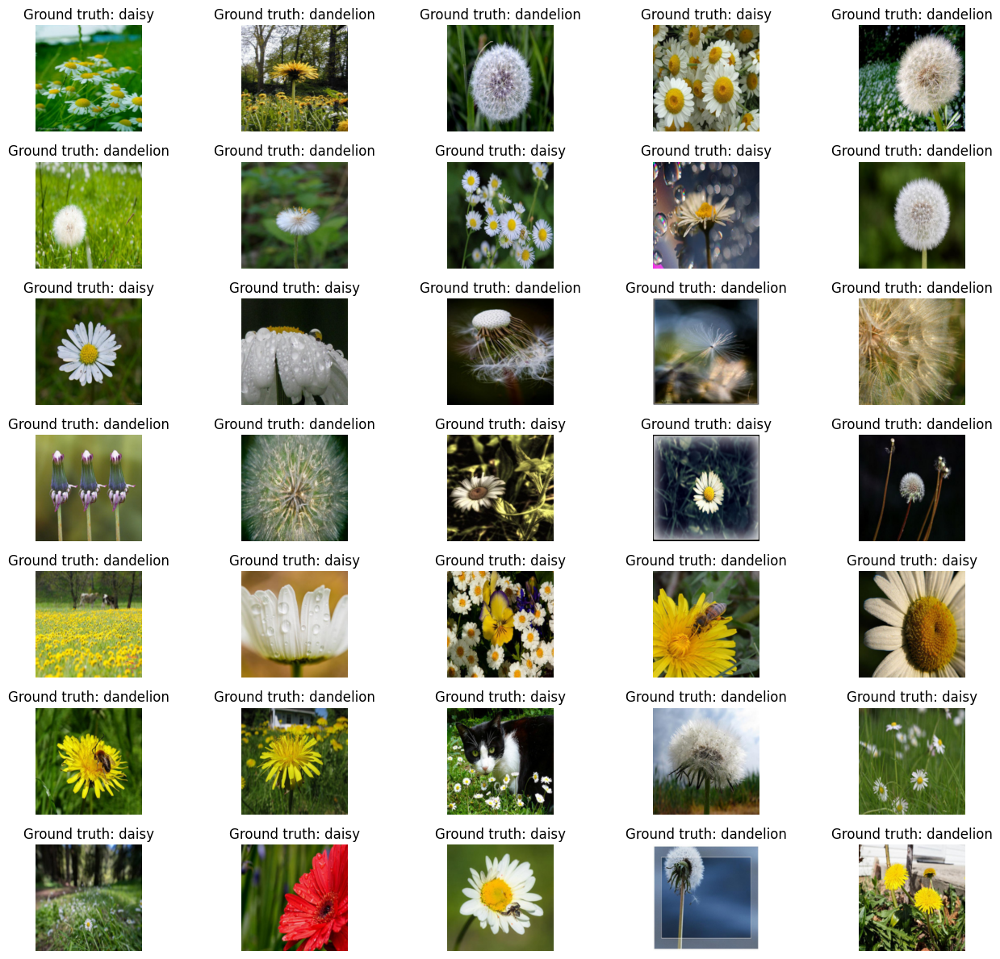

In [ ]:
dataset_inspection(train_loader, int_to_labels = int_to_labels,
                       num_images = 35, num_columns = 5, size = (15, 12))

In [ ]:
################# THIS CELL IS NEEDED ONLY THE FIRST TIME TO EXPLORE THE DATASET #################

def inspect_dataloader(dataloader, loader_type = None):
  """
  Scope: this function checks the labels distribution and computes [mean, standard
         deviation] of a dataloader;
  Input: a PyTorch DataLoader object;
  Return: mean and standard deviation of the dataset associated to the DataLoader, in RGB format.
  """
  if loader_type is not None:
    print(f"\t\t\t\t\tANALYZING THE {loader_type} DATASET")

  all_labels = []

  mean_sum = torch.zeros(3)
  square_sum = torch.zeros(3)
  total_pixels = 0

  for batch_images, batch_labels in tqdm(dataloader):
    B, C, H, W = batch_images.shape
    num_pixels_in_batch = B * H * W

    mean_sum += torch.sum(batch_images, dim = [0, 2, 3])
    square_sum += torch.sum(batch_images**2, dim = [0, 2, 3])

    all_labels.extend(batch_labels.tolist())
    total_pixels += num_pixels_in_batch

  mean_rgb = (mean_sum/total_pixels)
  mean_square_rgb = square_sum/total_pixels
  std_rgb = (torch.sqrt(mean_square_rgb - mean_rgb ** 2)) # very defintion of dev std

  all_labels = np.array(all_labels)
  labels_unique, label_counts = np.unique(all_labels, return_counts=True)
  total_labels = len(all_labels)
  for label, count in zip(labels_unique, label_counts):
    percentage = np.round(count/total_labels * 100, 2)
    print(f"There are {count} immagini ({percentage}%) belonging to class {label}.")

  print(f"The mean is {mean_rgb.tolist()} and the standard deviation is {std_rgb.tolist()}.\n")

  return [mean_rgb, std_rgb]
"""
mean_rgb, std_rgb = inspect_dataloader(train_loader, loader_type = "TRAIN")
_, _ = inspect_dataloader(valid_loader, loader_type = "VALIDATION")
_, _ = inspect_dataloader(test_loader, loader_type = "TEST")
"""

'\nmean_rgb, std_rgb = inspect_dataloader(train_loader, loader_type = "TRAIN")\n_, _ = inspect_dataloader(valid_loader, loader_type = "VALIDATION")\n_, _ = inspect_dataloader(test_loader, loader_type = "TEST")\n'

Dall'esecuzione della cella precedente, vediamo che le classi sono circa bilanciate (con una maggior popolazione nella classe $1$), che il test set rappresenta poco piu' del 10% dei dati totali, e che le $(\mu\,, \sigma)$ sui vari set sono simili (come ci si aspetta, d'altronde!). Possiamo quindi procedere a definire delle trasformazioni "baseline", su cui applicare i nostri modelli.  Testero' 3 modelli base su cui fare transfer learning. Uno piccolo (EfficientNet-B0), uno medio (ConvNeXt-Tiny) ed uno grande (VGG16):


In [ ]:
from torchvision.models import efficientnet_b0, EfficientNet_B0_Weights
from torchvision.models import convnext_tiny, ConvNeXt_Tiny_Weights
from torchvision.models import vgg16, VGG16_Weights

################## BASELINE MODEL: EfficientNet_B0 ##################
efficientnet_full = efficientnet_b0(weights = EfficientNet_B0_Weights.IMAGENET1K_V1)
for param in efficientnet_full.features.parameters():
  param.requires_grad = False
################## BASELINE MODEL: ConvNeXt_Tiny ##################
convnext_full = convnext_tiny(weights = ConvNeXt_Tiny_Weights.IMAGENET1K_V1)
for param in convnext_full.features.parameters():
  param.requires_grad = False
################## BASELINE MODEL: VGG16 ##################
vgg16_full = vgg16(weights = VGG16_Weights.IMAGENET1K_V1)
for param in vgg16_full.features.parameters():
  param.requires_grad = False

Per definire le augmentations, useremo albumentations (che e' piu' flessibile di torchvision per la data augmentation!). A tal fine, e' necessario definire una classe Transform:

In [ ]:
class Transforms:
  def __init__(self, augmentations):
    self._augmentations = augmentations
  def __call__(self, img, *args, **kwargs):
    return self._augmentations(image = np.array(img))['image']

## Step 0: Baseline - without data augmentation

In [ ]:
MEAN_RGB = [0.4193, 0.4291, 0.3032]
STD_RGB = [0.2850, 0.2603, 0.2888]
RESIZE_DIM = 224 # this is an hyperparameter

baseline_transforms = A.Compose([
    A.Resize(RESIZE_DIM, RESIZE_DIM),
    A.Normalize(mean = MEAN_RGB, std = STD_RGB),
    ToTensorV2()])

train_dataset = torchvision.datasets.ImageFolder(train_path,
                                                 transform = Transforms(baseline_transforms))
valid_dataset = torchvision.datasets.ImageFolder(valid_path,
                                                 transform = Transforms(baseline_transforms))

train_loader = data_utils.DataLoader(train_dataset, batch_size = 128, shuffle = True, num_workers = 2, pin_memory = True)
valid_loader = data_utils.DataLoader(valid_dataset, batch_size = 128, shuffle = False, num_workers = 2, pin_memory = True)

Visto che su colab si hanno poche risorse computazionali e visto che il problema non dovrebbe essere troppo difficile da affrontare (due classi, buon numero di dato), il tempo speso a fare training dovra' essere il minore possibile. Per questo motivo sara' fondamentale gestire al meglio il numero di epoche (attraverso la classe `EarlyStopping` -con poca `patience`- definita all'inizio) ed anche la velocita' del training (eventualmente diminuendo il batch size). Infine, la funzione per il train fdel modello definita all'inizio sfrutta la mixed precision di PyTorch per velocizzare alcuni passaggi.

**NB**: in senso assoluto, si dovrebbe fare hyperparameter tuning, ma non si potra' farlo in questo contesto in quanto richiederebbe troppe risorse di calcolo.

Il modello baseline qui sotto aggiunge il minor numero possibile di parametri, nel senso che la testa di classificazioni non ha layer nascosti. In pratica, e' come fare logistic regression dopo l'estrazione delle features:

In [ ]:
class BaselineModel(nn.Module):
  def __init__(self, backbone: nn.Module, N_f):
    """
    backbone: a nn.Module, which extracts the features;
    N_f: the number of feature maps in output of the backbone
    """
    super().__init__()
    self.features = backbone
    self.N_f = N_f
    self.classification_head = nn.Sequential(
        nn.AdaptiveAvgPool2d((1, 1)), # X.shape: [B, N_f, 1, 1]
        nn.Flatten(), # X.shape: [B, N_f]
        nn.Linear(self.N_f, 2)) # X.shape: [B, 2]

  def forward(self, X): # X.shape: [B, C = 3, RESIZE_DIM, RESIZE_DIM]
    X = self.features(X)  # X.shape: [B, N_f, ..., ...]
    X = self.classification_head(X) # X.shape: [B, 2]
    return X

X_example = torch.randn((1, 3, RESIZE_DIM, RESIZE_DIM)) # useful to uncover N_f, the number of filters for the models

N_f_efficientnet = efficientnet_full.features(X_example).shape[1]

N_f_convnext = convnext_full.features(X_example).shape[1]

N_f_vgg16 = vgg16_full.features(X_example).shape[1]

### EfficientNet

  3%|▎         | 1/30 [04:15<2:03:19, 255.14s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 1
Train accuracy: 0.659  -------------- Valid accuracy: 0.838.
Train loss: 0.619  --------------   Valid loss: 0.499.


  7%|▋         | 2/30 [04:20<50:29, 108.21s/it]  


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 2
Train accuracy: 0.847  -------------- Valid accuracy: 0.89.
Train loss: 0.475  --------------   Valid loss: 0.408.


 10%|█         | 3/30 [04:26<27:37, 61.38s/it] 


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 3
Train accuracy: 0.891  -------------- Valid accuracy: 0.912.
Train loss: 0.393  --------------   Valid loss: 0.353.


 13%|█▎        | 4/30 [04:31<16:59, 39.21s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 4
Train accuracy: 0.916  -------------- Valid accuracy: 0.923.
Train loss: 0.332  --------------   Valid loss: 0.315.


 17%|█▋        | 5/30 [04:36<11:15, 27.04s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 5
Train accuracy: 0.922  -------------- Valid accuracy: 0.92.
Train loss: 0.3  --------------   Valid loss: 0.288.


 20%|██        | 6/30 [04:42<07:50, 19.62s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 6
Train accuracy: 0.915  -------------- Valid accuracy: 0.923.
Train loss: 0.281  --------------   Valid loss: 0.268.


 23%|██▎       | 7/30 [04:47<05:42, 14.89s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 7
Train accuracy: 0.93  -------------- Valid accuracy: 0.931.
Train loss: 0.254  --------------   Valid loss: 0.253.


 27%|██▋       | 8/30 [04:52<04:20, 11.82s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 8
Train accuracy: 0.931  -------------- Valid accuracy: 0.931.
Train loss: 0.242  --------------   Valid loss: 0.243.


 30%|███       | 9/30 [04:57<03:25,  9.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 9
Train accuracy: 0.934  -------------- Valid accuracy: 0.929.
Train loss: 0.232  --------------   Valid loss: 0.231.


 33%|███▎      | 10/30 [05:03<02:48,  8.41s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 10
Train accuracy: 0.934  -------------- Valid accuracy: 0.929.
Train loss: 0.222  --------------   Valid loss: 0.223.


 37%|███▋      | 11/30 [05:08<02:21,  7.43s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 11
Train accuracy: 0.94  -------------- Valid accuracy: 0.931.
Train loss: 0.212  --------------   Valid loss: 0.217.


 40%|████      | 12/30 [05:13<02:00,  6.70s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 12
Train accuracy: 0.94  -------------- Valid accuracy: 0.931.
Train loss: 0.201  --------------   Valid loss: 0.211.


 43%|████▎     | 13/30 [05:18<01:46,  6.26s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 13
Train accuracy: 0.945  -------------- Valid accuracy: 0.929.
Train loss: 0.193  --------------   Valid loss: 0.206.


 47%|████▋     | 14/30 [05:23<01:34,  5.91s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 14
Train accuracy: 0.94  -------------- Valid accuracy: 0.931.
Train loss: 0.193  --------------   Valid loss: 0.202.


 50%|█████     | 15/30 [05:29<01:27,  5.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 15
Train accuracy: 0.94  -------------- Valid accuracy: 0.931.
Train loss: 0.19  --------------   Valid loss: 0.198.


 53%|█████▎    | 16/30 [05:34<01:18,  5.60s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 16
Train accuracy: 0.949  -------------- Valid accuracy: 0.931.
Train loss: 0.182  --------------   Valid loss: 0.195.


 57%|█████▋    | 17/30 [05:39<01:11,  5.52s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 17
Train accuracy: 0.941  -------------- Valid accuracy: 0.931.
Train loss: 0.175  --------------   Valid loss: 0.191.


 60%|██████    | 18/30 [05:44<01:05,  5.44s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 18
Train accuracy: 0.949  -------------- Valid accuracy: 0.929.
Train loss: 0.174  --------------   Valid loss: 0.19.


 63%|██████▎   | 19/30 [05:50<00:59,  5.37s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 19
Train accuracy: 0.947  -------------- Valid accuracy: 0.929.
Train loss: 0.164  --------------   Valid loss: 0.186.


 67%|██████▋   | 20/30 [05:55<00:53,  5.30s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 20
Train accuracy: 0.944  -------------- Valid accuracy: 0.931.
Train loss: 0.165  --------------   Valid loss: 0.184.


 70%|███████   | 21/30 [06:00<00:47,  5.25s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 21
Train accuracy: 0.947  -------------- Valid accuracy: 0.929.
Train loss: 0.163  --------------   Valid loss: 0.183.


 73%|███████▎  | 22/30 [06:05<00:42,  5.26s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 22
Train accuracy: 0.944  -------------- Valid accuracy: 0.929.
Train loss: 0.161  --------------   Valid loss: 0.18.


 77%|███████▋  | 23/30 [06:10<00:36,  5.25s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 23
Train accuracy: 0.96  -------------- Valid accuracy: 0.929.
Train loss: 0.145  --------------   Valid loss: 0.178.


 80%|████████  | 24/30 [06:16<00:31,  5.31s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 24
Train accuracy: 0.955  -------------- Valid accuracy: 0.929.
Train loss: 0.145  --------------   Valid loss: 0.177.


 83%|████████▎ | 25/30 [06:21<00:26,  5.25s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 25
Train accuracy: 0.958  -------------- Valid accuracy: 0.929.
Train loss: 0.147  --------------   Valid loss: 0.175.


 87%|████████▋ | 26/30 [06:26<00:20,  5.21s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 26
Train accuracy: 0.962  -------------- Valid accuracy: 0.929.
Train loss: 0.14  --------------   Valid loss: 0.173.


 90%|█████████ | 27/30 [06:31<00:15,  5.24s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 27
Train accuracy: 0.958  -------------- Valid accuracy: 0.931.
Train loss: 0.144  --------------   Valid loss: 0.171.


 93%|█████████▎| 28/30 [06:37<00:10,  5.31s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 28
Train accuracy: 0.961  -------------- Valid accuracy: 0.931.
Train loss: 0.137  --------------   Valid loss: 0.172.


 97%|█████████▋| 29/30 [06:42<00:05,  5.29s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 29
Train accuracy: 0.969  -------------- Valid accuracy: 0.931.
Train loss: 0.129  --------------   Valid loss: 0.171.


100%|██████████| 30/30 [06:47<00:00, 13.60s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 30
Train accuracy: 0.954  -------------- Valid accuracy: 0.929.
Train loss: 0.14  --------------   Valid loss: 0.169.


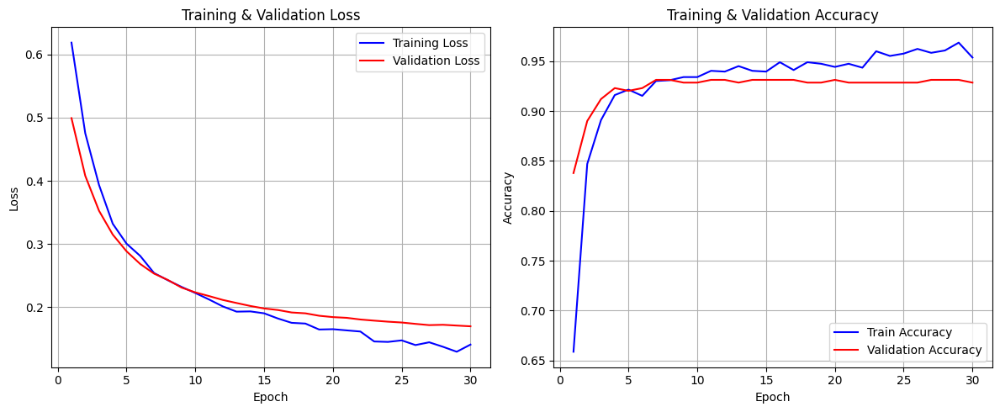

In [ ]:
my_efficientnet = BaselineModel(backbone = efficientnet_full.features,
                                N_f = N_f_efficientnet).to(device)

EPOCHS = 30

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_efficientnet.parameters(), lr = 0.0005)
early_stopping = EarlyStopping(path = './checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_efficientnet, loss_fn, optimizer,
                                     train_loader, valid_loader,
                                     epochs = EPOCHS, verbose = True,
                                     confusion_matrix_data = True,
                                     early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.970980,0.970022,0.971600,0.968603
Validation/Test,0.928571,0.927608,0.928823,0.926625


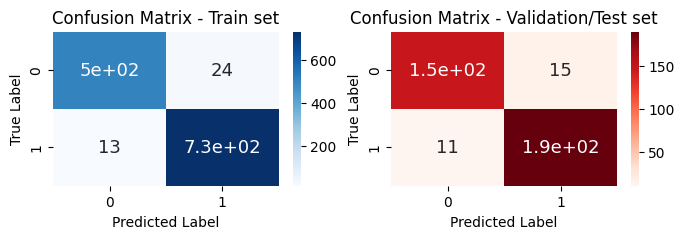

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

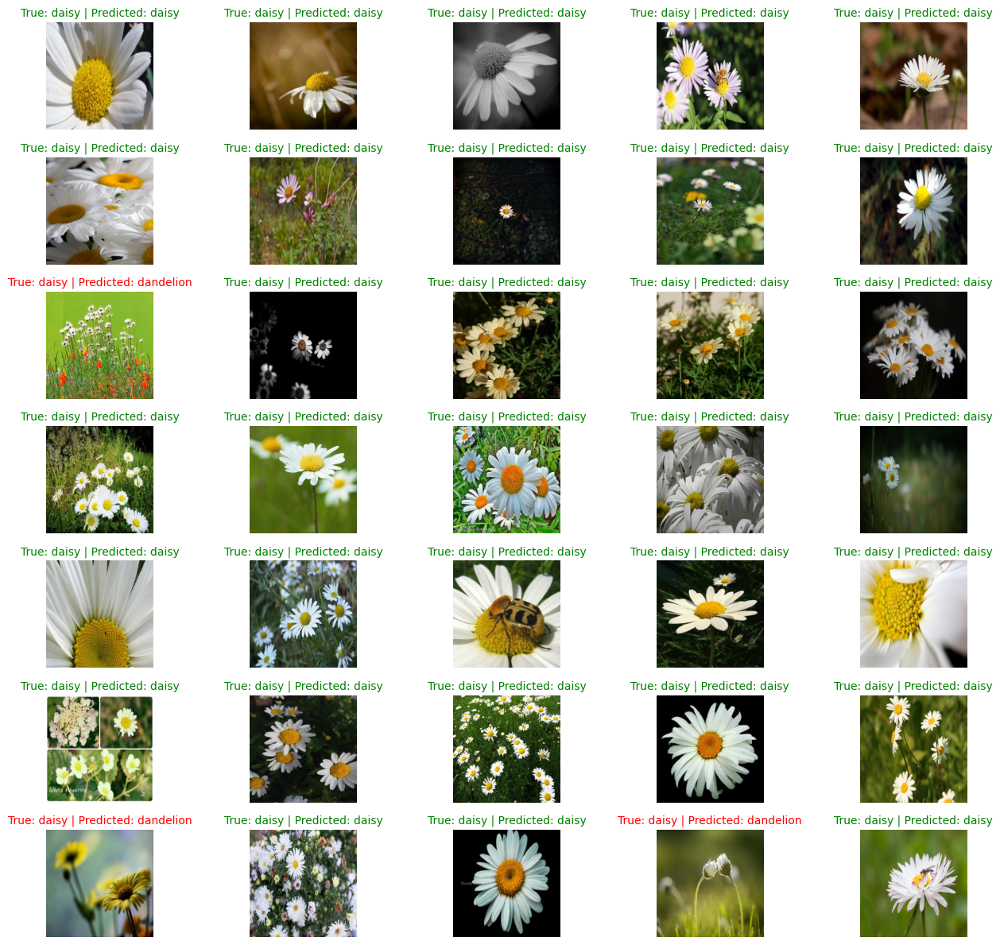

In [ ]:
show_predictions(my_efficientnet, loader = valid_loader, mean = MEAN_RGB, std = STD_RGB, int_to_labels = int_to_labels,
                     num_images = 35, num_columns = 5, size = (15, 12))

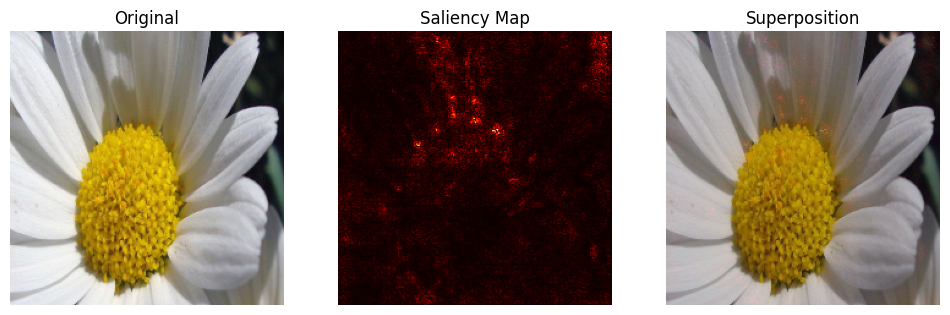

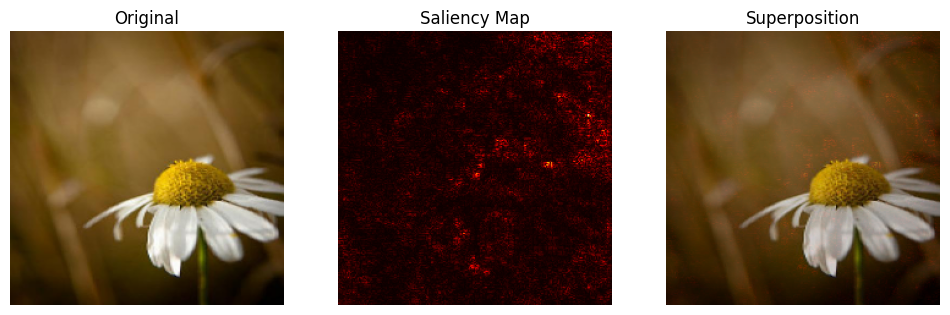

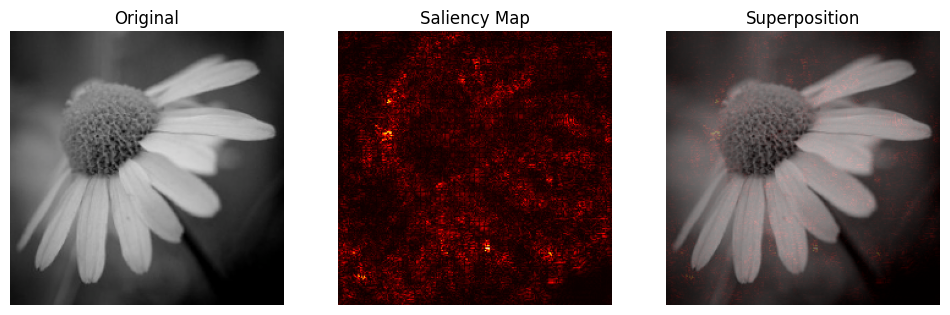

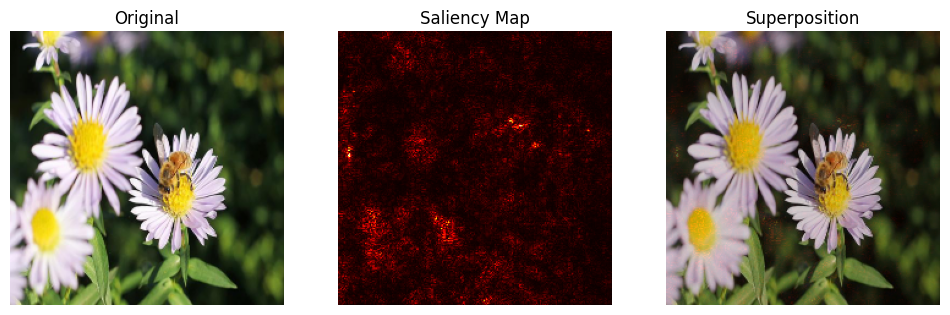

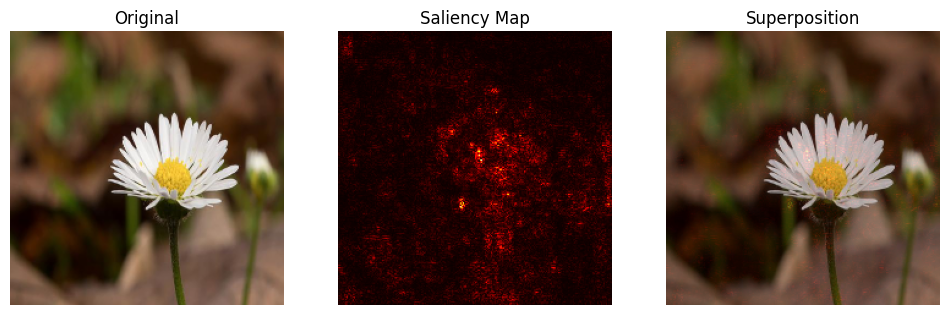

In [ ]:
sm = SaliencyMAP(my_efficientnet)

explain_predictions(sm, valid_loader, num_images = 5,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,6))

### ConvNeXt

  3%|▎         | 1/30 [00:21<10:20, 21.40s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 1
Train accuracy: 0.734  -------------- Valid accuracy: 0.912.
Train loss: 0.641  --------------   Valid loss: 0.6.


  7%|▋         | 2/30 [00:27<05:48, 12.45s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 2
Train accuracy: 0.902  -------------- Valid accuracy: 0.904.
Train loss: 0.571  --------------   Valid loss: 0.529.


 10%|█         | 3/30 [00:33<04:13,  9.38s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 3
Train accuracy: 0.916  -------------- Valid accuracy: 0.909.
Train loss: 0.509  --------------   Valid loss: 0.472.

 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 4
Train accuracy: 0.914  -------------- Valid accuracy: 0.909.
Train loss: 0.464  --------------   Valid loss: 0.426.


 13%|█▎        | 4/30 [00:39<03:31,  8.13s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 5
Train accuracy: 0.92  -------------- Valid accuracy: 0.912.
Train loss: 0.421  --------------   Valid loss: 0.389.


 20%|██        | 6/30 [00:51<02:45,  6.88s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 6
Train accuracy: 0.917  -------------- Valid accuracy: 0.912.
Train loss: 0.388  --------------   Valid loss: 0.359.


 23%|██▎       | 7/30 [00:57<02:30,  6.53s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 7
Train accuracy: 0.922  -------------- Valid accuracy: 0.923.
Train loss: 0.36  --------------   Valid loss: 0.334.

 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 8
Train accuracy: 0.922  -------------- Valid accuracy: 0.923.
Train loss: 0.342  --------------   Valid loss: 0.314.


 30%|███       | 9/30 [01:08<02:08,  6.12s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 9
Train accuracy: 0.922  -------------- Valid accuracy: 0.926.
Train loss: 0.323  --------------   Valid loss: 0.296.


 33%|███▎      | 10/30 [01:14<02:01,  6.07s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 10
Train accuracy: 0.929  -------------- Valid accuracy: 0.926.
Train loss: 0.305  --------------   Valid loss: 0.282.


 37%|███▋      | 11/30 [01:20<01:53,  5.95s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 11
Train accuracy: 0.926  -------------- Valid accuracy: 0.926.
Train loss: 0.294  --------------   Valid loss: 0.269.


 40%|████      | 12/30 [01:26<01:47,  5.98s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 12
Train accuracy: 0.931  -------------- Valid accuracy: 0.929.
Train loss: 0.278  --------------   Valid loss: 0.258.


 43%|████▎     | 13/30 [01:32<01:41,  5.94s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 13
Train accuracy: 0.929  -------------- Valid accuracy: 0.929.
Train loss: 0.273  --------------   Valid loss: 0.248.


 47%|████▋     | 14/30 [01:38<01:34,  5.90s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 14
Train accuracy: 0.937  -------------- Valid accuracy: 0.929.
Train loss: 0.259  --------------   Valid loss: 0.239.


 50%|█████     | 15/30 [01:43<01:27,  5.86s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 15
Train accuracy: 0.925  -------------- Valid accuracy: 0.929.
Train loss: 0.252  --------------   Valid loss: 0.231.


 53%|█████▎    | 16/30 [01:49<01:21,  5.83s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 16
Train accuracy: 0.937  -------------- Valid accuracy: 0.929.
Train loss: 0.245  --------------   Valid loss: 0.224.

 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 17
Train accuracy: 0.933  -------------- Valid accuracy: 0.929.
Train loss: 0.238  --------------   Valid loss: 0.217.


 60%|██████    | 18/30 [02:01<01:09,  5.83s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 18
Train accuracy: 0.934  -------------- Valid accuracy: 0.929.
Train loss: 0.229  --------------   Valid loss: 0.212.


 63%|██████▎   | 19/30 [02:06<01:03,  5.77s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 19
Train accuracy: 0.94  -------------- Valid accuracy: 0.929.
Train loss: 0.222  --------------   Valid loss: 0.206.


 67%|██████▋   | 20/30 [02:12<00:58,  5.81s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 20
Train accuracy: 0.941  -------------- Valid accuracy: 0.929.
Train loss: 0.221  --------------   Valid loss: 0.201.


 70%|███████   | 21/30 [02:18<00:53,  5.89s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 21
Train accuracy: 0.94  -------------- Valid accuracy: 0.929.
Train loss: 0.216  --------------   Valid loss: 0.196.


 73%|███████▎  | 22/30 [02:24<00:47,  5.97s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 22
Train accuracy: 0.944  -------------- Valid accuracy: 0.929.
Train loss: 0.21  --------------   Valid loss: 0.192.


 77%|███████▋  | 23/30 [02:31<00:41,  5.99s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 23
Train accuracy: 0.948  -------------- Valid accuracy: 0.929.
Train loss: 0.199  --------------   Valid loss: 0.188.


 80%|████████  | 24/30 [02:37<00:36,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 24
Train accuracy: 0.943  -------------- Valid accuracy: 0.934.
Train loss: 0.2  --------------   Valid loss: 0.184.


 83%|████████▎ | 25/30 [02:42<00:29,  5.95s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 25
Train accuracy: 0.938  -------------- Valid accuracy: 0.931.
Train loss: 0.197  --------------   Valid loss: 0.181.


 87%|████████▋ | 26/30 [02:48<00:23,  5.90s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 26
Train accuracy: 0.937  -------------- Valid accuracy: 0.934.
Train loss: 0.198  --------------   Valid loss: 0.178.


 90%|█████████ | 27/30 [02:54<00:17,  5.88s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 27
Train accuracy: 0.944  -------------- Valid accuracy: 0.934.
Train loss: 0.19  --------------   Valid loss: 0.175.


 93%|█████████▎| 28/30 [03:00<00:11,  5.83s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 28
Train accuracy: 0.946  -------------- Valid accuracy: 0.934.
Train loss: 0.185  --------------   Valid loss: 0.172.


 97%|█████████▋| 29/30 [03:06<00:05,  5.90s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 29
Train accuracy: 0.946  -------------- Valid accuracy: 0.934.
Train loss: 0.185  --------------   Valid loss: 0.17.


100%|██████████| 30/30 [03:12<00:00,  6.40s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 30
Train accuracy: 0.953  -------------- Valid accuracy: 0.934.
Train loss: 0.182  --------------   Valid loss: 0.167.


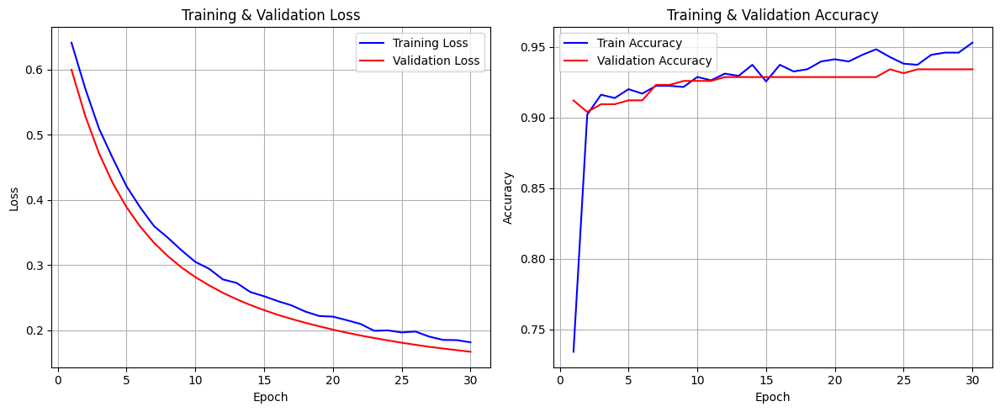

In [ ]:
my_convnext = BaselineModel(backbone = convnext_full.features,
                            N_f = N_f_convnext).to(device)

EPOCHS = 30

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_convnext.parameters(), lr = 0.0005)
early_stopping = EarlyStopping(path = './checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_convnext, loss_fn, optimizer,
                                      train_loader, valid_loader,
                                      epochs = EPOCHS, verbose = True,
                                      confusion_matrix_data = True,
                                      early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.949020,0.947305,0.949115,0.945712
Validation/Test,0.934066,0.933415,0.932968,0.933919


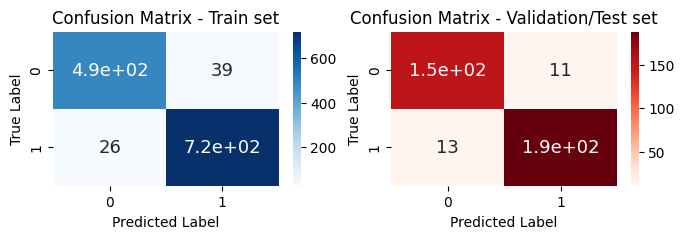

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

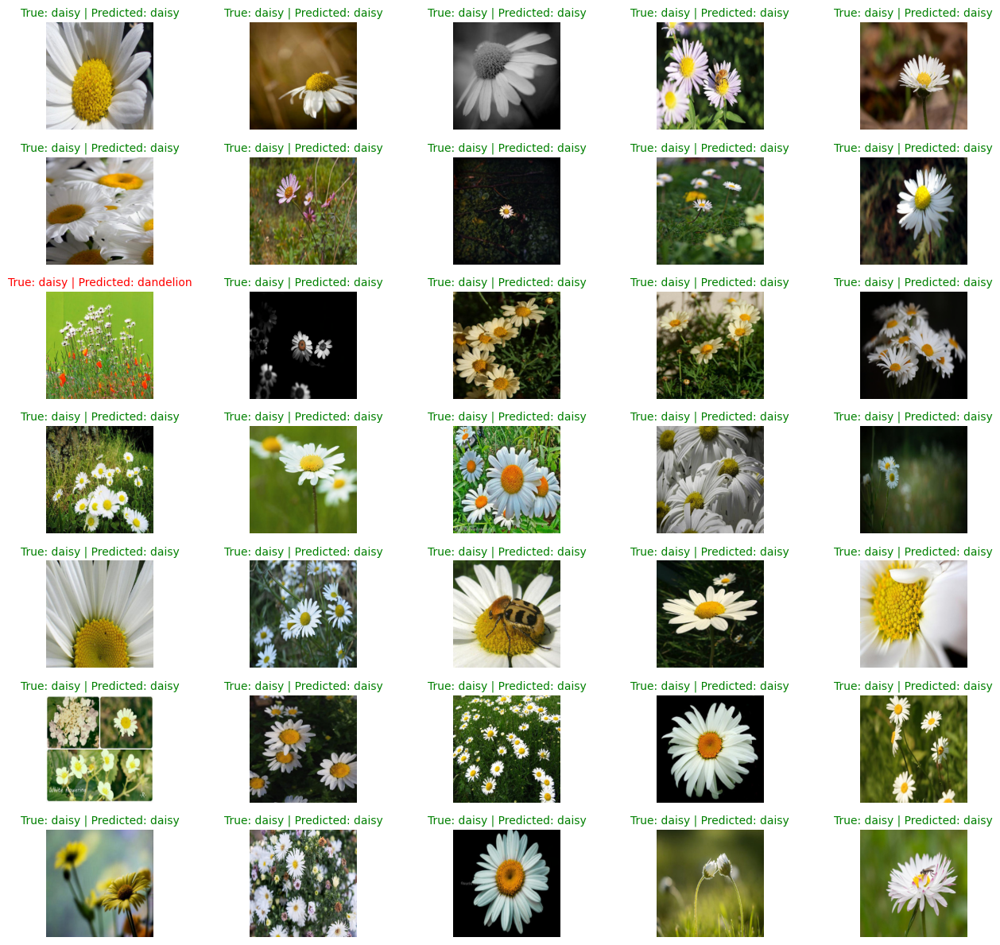

In [ ]:
show_predictions(my_convnext, loader = valid_loader, mean = MEAN_RGB, std = STD_RGB, int_to_labels = int_to_labels,
                     num_images = 35, num_columns = 5, size = (15, 12))

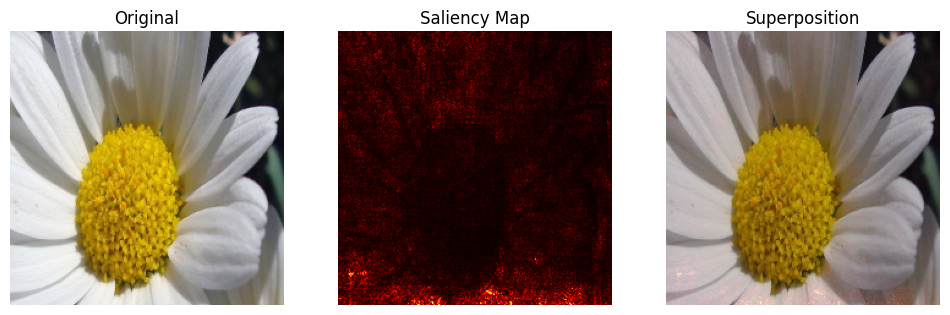

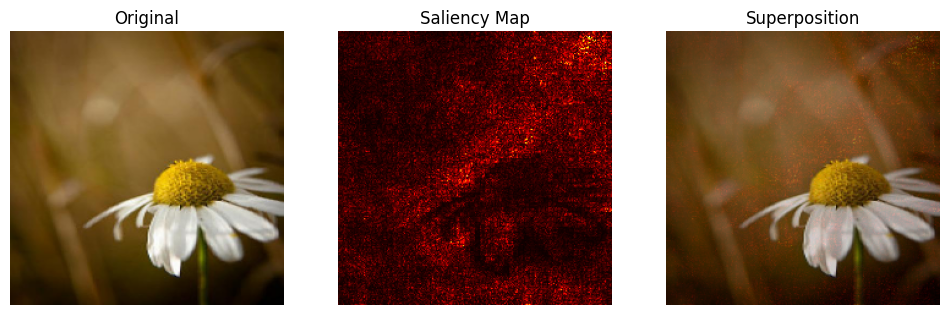

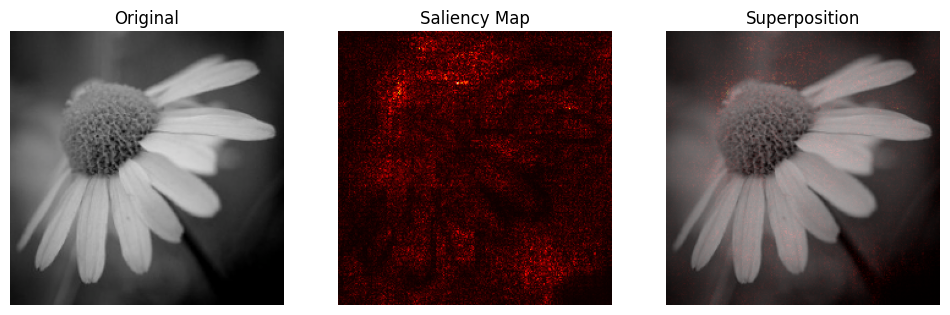

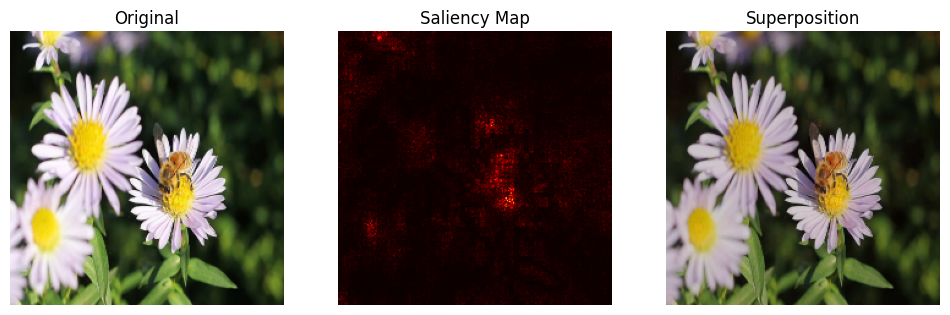

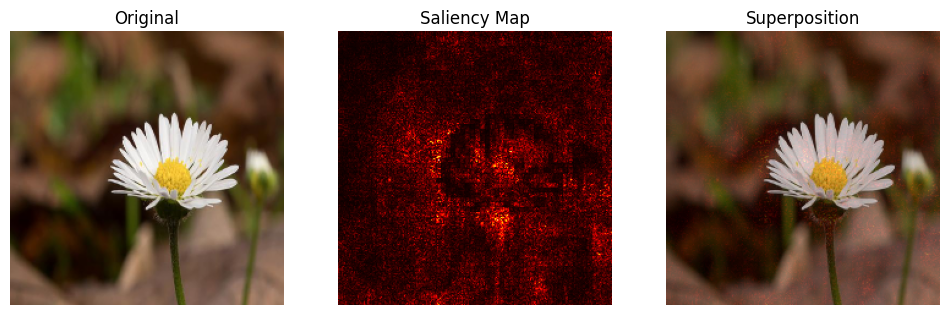

In [ ]:
sm = SaliencyMAP(my_convnext)

explain_predictions(sm, valid_loader, num_images = 5,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,6))

### VGG16

  3%|▎         | 1/30 [00:05<02:34,  5.32s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 1
Train accuracy: 0.557  -------------- Valid accuracy: 0.547.
Train loss: 0.727  --------------   Valid loss: 0.687.


  7%|▋         | 2/30 [00:11<02:35,  5.54s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 2
Train accuracy: 0.685  -------------- Valid accuracy: 0.747.
Train loss: 0.617  --------------   Valid loss: 0.583.


 10%|█         | 3/30 [00:16<02:27,  5.45s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 3
Train accuracy: 0.805  -------------- Valid accuracy: 0.824.
Train loss: 0.533  --------------   Valid loss: 0.508.


 13%|█▎        | 4/30 [00:22<02:26,  5.63s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 4
Train accuracy: 0.845  -------------- Valid accuracy: 0.843.
Train loss: 0.473  --------------   Valid loss: 0.454.


 17%|█▋        | 5/30 [00:27<02:19,  5.58s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 5
Train accuracy: 0.859  -------------- Valid accuracy: 0.86.
Train loss: 0.429  --------------   Valid loss: 0.415.


 20%|██        | 6/30 [00:33<02:13,  5.56s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 6
Train accuracy: 0.871  -------------- Valid accuracy: 0.874.
Train loss: 0.396  --------------   Valid loss: 0.387.


 23%|██▎       | 7/30 [00:38<02:07,  5.55s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 7
Train accuracy: 0.876  -------------- Valid accuracy: 0.882.
Train loss: 0.371  --------------   Valid loss: 0.365.


 27%|██▋       | 8/30 [00:44<02:02,  5.58s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 8
Train accuracy: 0.882  -------------- Valid accuracy: 0.885.
Train loss: 0.351  --------------   Valid loss: 0.347.


 30%|███       | 9/30 [00:49<01:54,  5.46s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 9
Train accuracy: 0.892  -------------- Valid accuracy: 0.89.
Train loss: 0.333  --------------   Valid loss: 0.331.


 33%|███▎      | 10/30 [00:54<01:48,  5.42s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 10
Train accuracy: 0.896  -------------- Valid accuracy: 0.89.
Train loss: 0.319  --------------   Valid loss: 0.32.


 37%|███▋      | 11/30 [01:00<01:44,  5.50s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 11
Train accuracy: 0.9  -------------- Valid accuracy: 0.896.
Train loss: 0.306  --------------   Valid loss: 0.309.


 40%|████      | 12/30 [01:06<01:39,  5.51s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 12
Train accuracy: 0.904  -------------- Valid accuracy: 0.904.
Train loss: 0.295  --------------   Valid loss: 0.299.


 43%|████▎     | 13/30 [01:11<01:34,  5.55s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 13
Train accuracy: 0.907  -------------- Valid accuracy: 0.907.
Train loss: 0.285  --------------   Valid loss: 0.291.


 47%|████▋     | 14/30 [01:17<01:28,  5.52s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 14
Train accuracy: 0.907  -------------- Valid accuracy: 0.907.
Train loss: 0.276  --------------   Valid loss: 0.282.


 50%|█████     | 15/30 [01:22<01:22,  5.50s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 15
Train accuracy: 0.911  -------------- Valid accuracy: 0.907.
Train loss: 0.268  --------------   Valid loss: 0.277.


 53%|█████▎    | 16/30 [01:28<01:17,  5.50s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 16
Train accuracy: 0.916  -------------- Valid accuracy: 0.912.
Train loss: 0.261  --------------   Valid loss: 0.27.


 57%|█████▋    | 17/30 [01:33<01:12,  5.57s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 17
Train accuracy: 0.917  -------------- Valid accuracy: 0.918.
Train loss: 0.254  --------------   Valid loss: 0.265.


 60%|██████    | 18/30 [01:39<01:06,  5.54s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 18
Train accuracy: 0.919  -------------- Valid accuracy: 0.92.
Train loss: 0.248  --------------   Valid loss: 0.26.


 63%|██████▎   | 19/30 [01:44<01:00,  5.47s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 19
Train accuracy: 0.92  -------------- Valid accuracy: 0.918.
Train loss: 0.242  --------------   Valid loss: 0.254.


 67%|██████▋   | 20/30 [01:50<00:54,  5.46s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 20
Train accuracy: 0.922  -------------- Valid accuracy: 0.92.
Train loss: 0.237  --------------   Valid loss: 0.25.


 70%|███████   | 21/30 [01:55<00:49,  5.50s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 21
Train accuracy: 0.924  -------------- Valid accuracy: 0.92.
Train loss: 0.232  --------------   Valid loss: 0.245.


 73%|███████▎  | 22/30 [02:01<00:44,  5.52s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 22
Train accuracy: 0.925  -------------- Valid accuracy: 0.92.
Train loss: 0.227  --------------   Valid loss: 0.244.


 77%|███████▋  | 23/30 [02:06<00:38,  5.48s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 23
Train accuracy: 0.928  -------------- Valid accuracy: 0.92.
Train loss: 0.223  --------------   Valid loss: 0.24.


 80%|████████  | 24/30 [02:12<00:33,  5.55s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 24
Train accuracy: 0.928  -------------- Valid accuracy: 0.923.
Train loss: 0.218  --------------   Valid loss: 0.235.


 83%|████████▎ | 25/30 [02:17<00:27,  5.55s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 25
Train accuracy: 0.928  -------------- Valid accuracy: 0.923.
Train loss: 0.215  --------------   Valid loss: 0.233.


 87%|████████▋ | 26/30 [02:23<00:22,  5.61s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 26
Train accuracy: 0.93  -------------- Valid accuracy: 0.923.
Train loss: 0.211  --------------   Valid loss: 0.23.


 90%|█████████ | 27/30 [02:29<00:17,  5.67s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 27
Train accuracy: 0.931  -------------- Valid accuracy: 0.923.
Train loss: 0.207  --------------   Valid loss: 0.228.


 93%|█████████▎| 28/30 [02:35<00:11,  5.74s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 28
Train accuracy: 0.932  -------------- Valid accuracy: 0.923.
Train loss: 0.204  --------------   Valid loss: 0.225.


 97%|█████████▋| 29/30 [02:40<00:05,  5.66s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 29
Train accuracy: 0.933  -------------- Valid accuracy: 0.923.
Train loss: 0.201  --------------   Valid loss: 0.223.


100%|██████████| 30/30 [02:46<00:00,  5.55s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 30
Train accuracy: 0.93  -------------- Valid accuracy: 0.923.
Train loss: 0.198  --------------   Valid loss: 0.219.


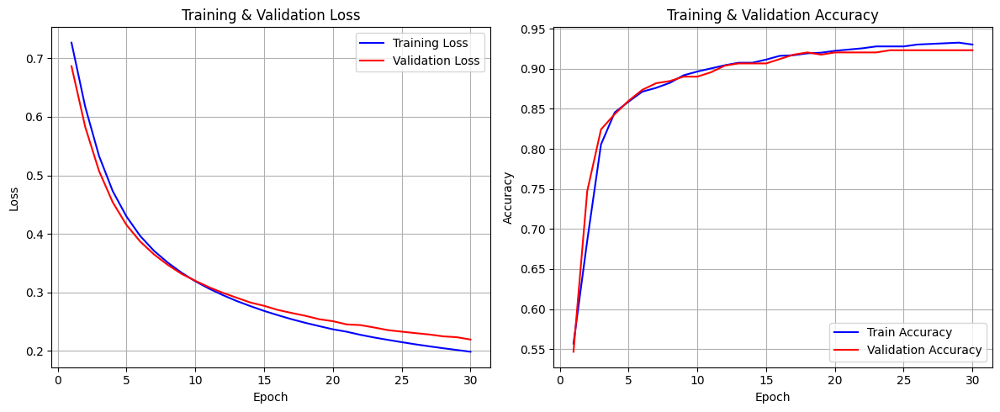

In [ ]:
my_vgg16 = BaselineModel(backbone = vgg16_full.features,
                         N_f = N_f_vgg16).to(device)

EPOCHS = 30

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_vgg16.parameters(), lr = 0.0005)
early_stopping = EarlyStopping(path = './checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_vgg16, loss_fn, optimizer,
                                      train_loader, valid_loader,
                                      epochs = EPOCHS, verbose = True,
                                      confusion_matrix_data = True,
                                      early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.930196,0.927264,0.933725,0.922752
Validation/Test,0.923077,0.922039,0.923240,0.921069


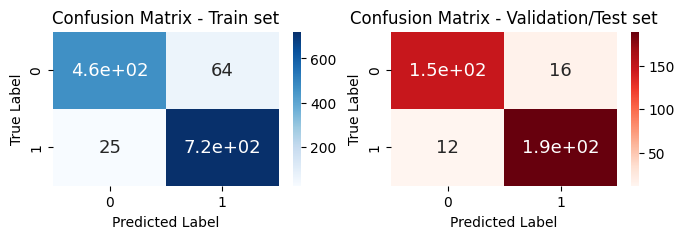

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

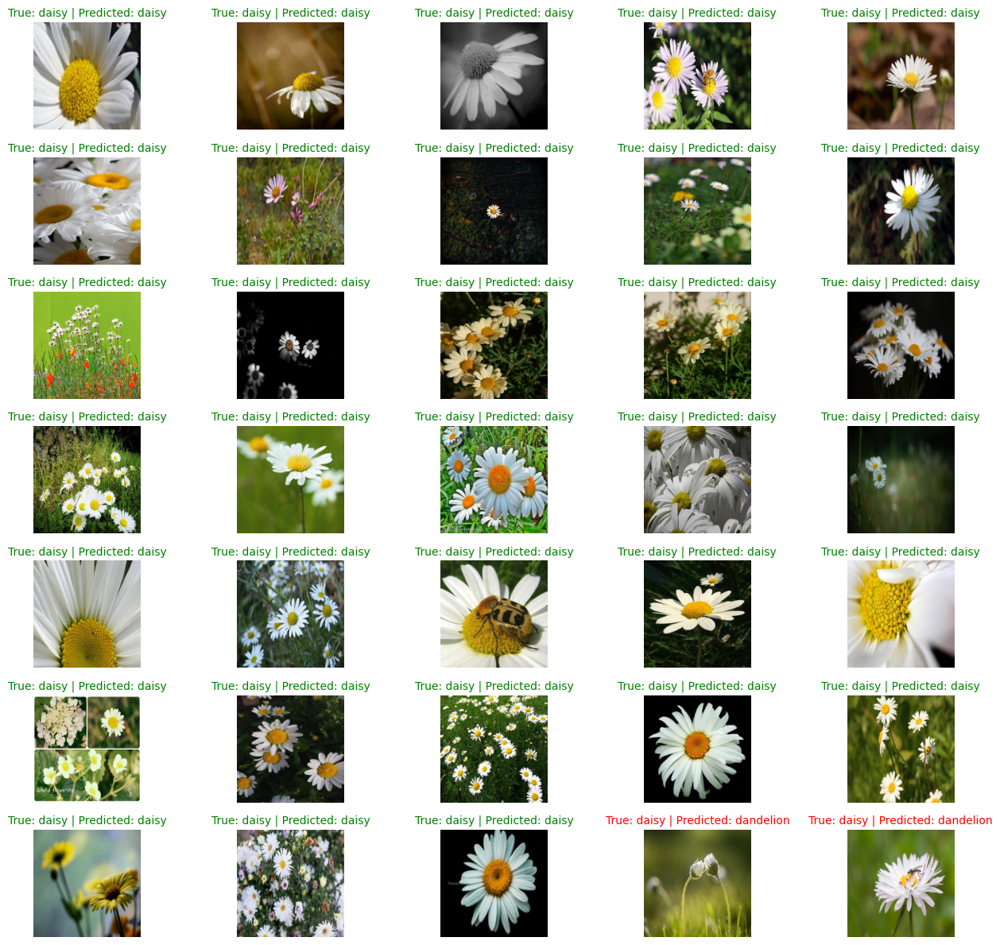

In [ ]:
show_predictions(my_vgg16, loader = valid_loader, mean = MEAN_RGB, std = STD_RGB, int_to_labels = int_to_labels,
                     num_images = 35, num_columns = 5, size = (15, 12))

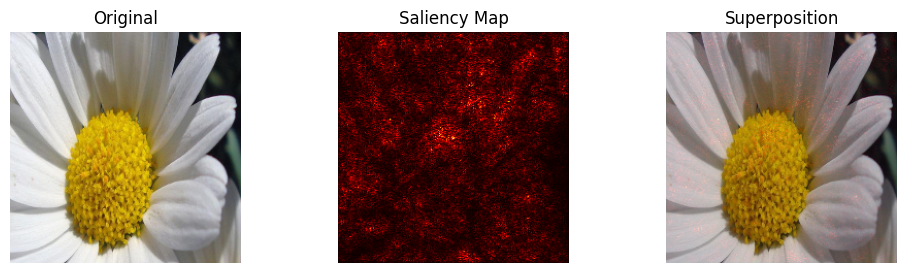

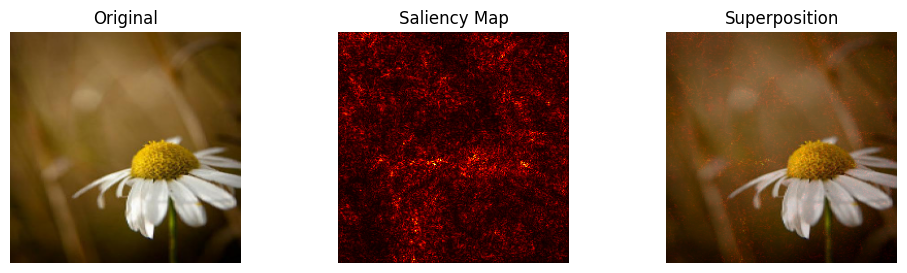

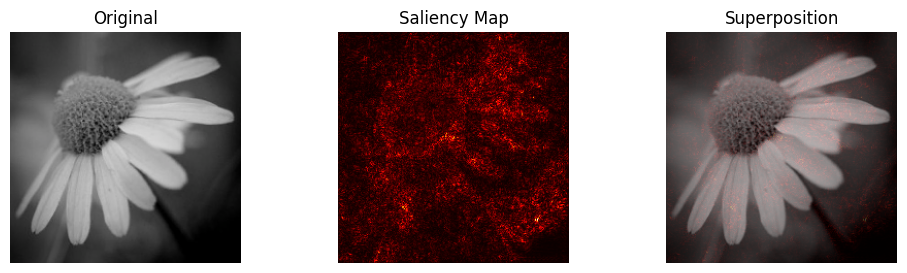

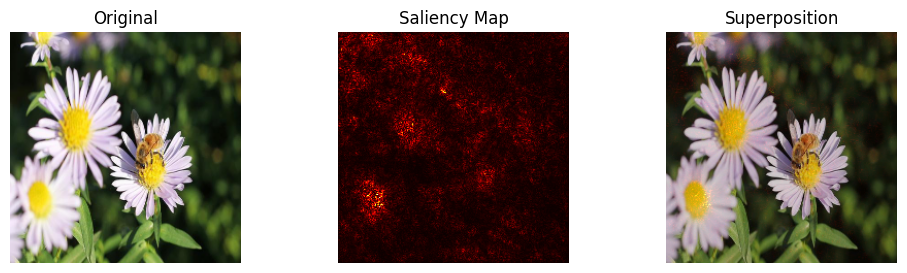

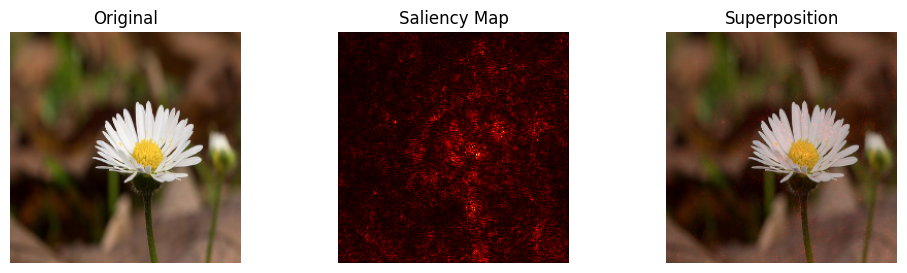

In [ ]:
sm = SaliencyMAP(my_vgg16)

explain_predictions(sm, valid_loader, num_images = 5,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,3))

## Step 1: Baseline - with data augmentation

Tutti i tre modelli escelti raggiungono buone performance sul validation set, con una accuracy di circa 92% ed un F1-score paragonabile. Tuttavia, possiamo provare a raggiungere performances migliori regolarizzando la rete, sfruttando la data augmentation.

In particolare, il validation set (e poi il test set!) manterranno delle trasformazioni di base, mentre il train set verra' reso piu' sfidante con delle trasformazioni.

In [ ]:
augments = A.Compose([
    A.Resize(RESIZE_DIM, RESIZE_DIM),
    A.Normalize(mean = MEAN_RGB, std = STD_RGB),
    A.RandomRotate90(p = 0.4),
    A.HorizontalFlip(p = 0.4),
    A.VerticalFlip(p = 0.4),
    A.Transpose(),
    ToTensorV2()])

train_dataset = torchvision.datasets.ImageFolder(train_path,
                                                 transform = Transforms(augments))
valid_dataset = torchvision.datasets.ImageFolder(valid_path,
                                                 transform = Transforms(baseline_transforms))

train_loader = data_utils.DataLoader(train_dataset, batch_size = 128, shuffle = True, num_workers = 2, pin_memory = True)
valid_loader = data_utils.DataLoader(valid_dataset, batch_size = 128, shuffle = False, num_workers = 2, pin_memory = True)

### EfficientNet

  3%|▎         | 1/30 [00:07<03:49,  7.92s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 1
Train accuracy: 0.604  -------------- Valid accuracy: 0.83.
Train loss: 0.65  --------------   Valid loss: 0.519.


  7%|▋         | 2/30 [00:13<03:10,  6.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 2
Train accuracy: 0.82  -------------- Valid accuracy: 0.871.
Train loss: 0.502  --------------   Valid loss: 0.426.


 10%|█         | 3/30 [00:19<02:48,  6.25s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 3
Train accuracy: 0.885  -------------- Valid accuracy: 0.885.
Train loss: 0.417  --------------   Valid loss: 0.37.


 13%|█▎        | 4/30 [00:25<02:36,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 4
Train accuracy: 0.894  -------------- Valid accuracy: 0.898.
Train loss: 0.359  --------------   Valid loss: 0.333.


 17%|█▋        | 5/30 [00:30<02:27,  5.91s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 5
Train accuracy: 0.9  -------------- Valid accuracy: 0.901.
Train loss: 0.323  --------------   Valid loss: 0.307.


 20%|██        | 6/30 [00:36<02:22,  5.96s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 6
Train accuracy: 0.897  -------------- Valid accuracy: 0.912.
Train loss: 0.303  --------------   Valid loss: 0.284.


 23%|██▎       | 7/30 [00:42<02:17,  5.97s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 7
Train accuracy: 0.912  -------------- Valid accuracy: 0.912.
Train loss: 0.281  --------------   Valid loss: 0.27.


 27%|██▋       | 8/30 [00:48<02:09,  5.88s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 8
Train accuracy: 0.917  -------------- Valid accuracy: 0.92.
Train loss: 0.261  --------------   Valid loss: 0.258.


 30%|███       | 9/30 [00:54<02:02,  5.82s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 9
Train accuracy: 0.927  -------------- Valid accuracy: 0.926.
Train loss: 0.252  --------------   Valid loss: 0.248.


 33%|███▎      | 10/30 [01:00<01:56,  5.81s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 10
Train accuracy: 0.919  -------------- Valid accuracy: 0.929.
Train loss: 0.24  --------------   Valid loss: 0.238.


 37%|███▋      | 11/30 [01:05<01:50,  5.83s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 11
Train accuracy: 0.922  -------------- Valid accuracy: 0.931.
Train loss: 0.23  --------------   Valid loss: 0.231.


 40%|████      | 12/30 [01:11<01:43,  5.75s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 12
Train accuracy: 0.929  -------------- Valid accuracy: 0.934.
Train loss: 0.225  --------------   Valid loss: 0.223.


 43%|████▎     | 13/30 [01:17<01:38,  5.79s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 13
Train accuracy: 0.931  -------------- Valid accuracy: 0.934.
Train loss: 0.217  --------------   Valid loss: 0.219.


 47%|████▋     | 14/30 [01:23<01:32,  5.79s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 14
Train accuracy: 0.925  -------------- Valid accuracy: 0.934.
Train loss: 0.215  --------------   Valid loss: 0.214.


 50%|█████     | 15/30 [01:29<01:27,  5.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 15
Train accuracy: 0.922  -------------- Valid accuracy: 0.934.
Train loss: 0.216  --------------   Valid loss: 0.211.


 53%|█████▎    | 16/30 [01:34<01:21,  5.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 16
Train accuracy: 0.939  -------------- Valid accuracy: 0.934.
Train loss: 0.2  --------------   Valid loss: 0.207.


 57%|█████▋    | 17/30 [01:40<01:15,  5.78s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 17
Train accuracy: 0.942  -------------- Valid accuracy: 0.934.
Train loss: 0.193  --------------   Valid loss: 0.204.


 60%|██████    | 18/30 [01:46<01:09,  5.77s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 18
Train accuracy: 0.939  -------------- Valid accuracy: 0.931.
Train loss: 0.191  --------------   Valid loss: 0.2.


 63%|██████▎   | 19/30 [01:52<01:03,  5.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 19
Train accuracy: 0.933  -------------- Valid accuracy: 0.931.
Train loss: 0.189  --------------   Valid loss: 0.198.


 67%|██████▋   | 20/30 [01:57<00:57,  5.77s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 20
Train accuracy: 0.937  -------------- Valid accuracy: 0.934.
Train loss: 0.186  --------------   Valid loss: 0.195.


 70%|███████   | 21/30 [02:03<00:52,  5.79s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 21
Train accuracy: 0.934  -------------- Valid accuracy: 0.937.
Train loss: 0.188  --------------   Valid loss: 0.193.


 73%|███████▎  | 22/30 [02:09<00:46,  5.79s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 22
Train accuracy: 0.935  -------------- Valid accuracy: 0.931.
Train loss: 0.174  --------------   Valid loss: 0.191.


 77%|███████▋  | 23/30 [02:15<00:40,  5.81s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 23
Train accuracy: 0.936  -------------- Valid accuracy: 0.929.
Train loss: 0.179  --------------   Valid loss: 0.189.


 80%|████████  | 24/30 [02:21<00:34,  5.78s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 24
Train accuracy: 0.94  -------------- Valid accuracy: 0.931.
Train loss: 0.179  --------------   Valid loss: 0.187.


 83%|████████▎ | 25/30 [02:26<00:28,  5.74s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 25
Train accuracy: 0.937  -------------- Valid accuracy: 0.931.
Train loss: 0.18  --------------   Valid loss: 0.186.


 87%|████████▋ | 26/30 [02:32<00:23,  5.80s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 26
Train accuracy: 0.947  -------------- Valid accuracy: 0.931.
Train loss: 0.165  --------------   Valid loss: 0.185.


 90%|█████████ | 27/30 [02:38<00:17,  5.76s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 27
Train accuracy: 0.947  -------------- Valid accuracy: 0.929.
Train loss: 0.158  --------------   Valid loss: 0.183.


 93%|█████████▎| 28/30 [02:44<00:11,  5.79s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 28
Train accuracy: 0.95  -------------- Valid accuracy: 0.931.
Train loss: 0.154  --------------   Valid loss: 0.182.


 97%|█████████▋| 29/30 [02:49<00:05,  5.78s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 29
Train accuracy: 0.941  -------------- Valid accuracy: 0.934.
Train loss: 0.164  --------------   Valid loss: 0.181.


100%|██████████| 30/30 [02:55<00:00,  5.86s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 30
Train accuracy: 0.947  -------------- Valid accuracy: 0.934.
Train loss: 0.161  --------------   Valid loss: 0.18.


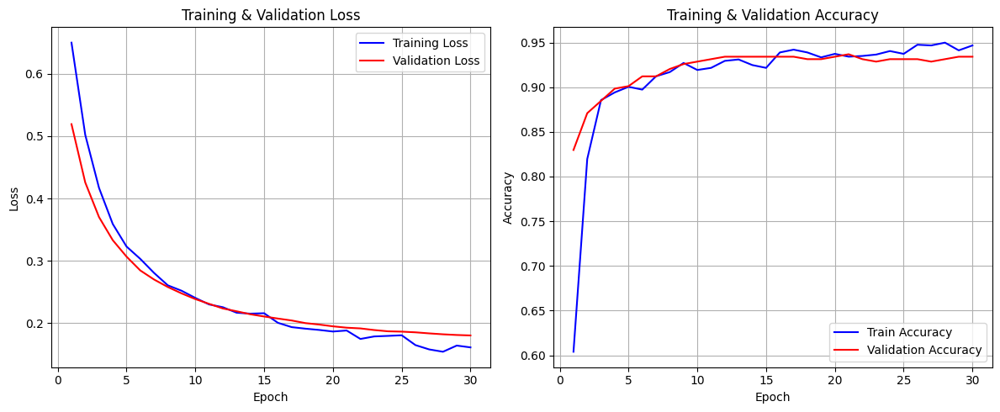

In [ ]:
my_efficientnet = BaselineModel(backbone = efficientnet_full.features,
                                N_f = N_f_efficientnet).to(device)

EPOCHS = 30

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_efficientnet.parameters(), lr = 0.0005)
early_stopping = EarlyStopping(path = './checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_efficientnet, loss_fn, optimizer,
                                     train_loader, valid_loader,
                                     epochs = EPOCHS, verbose = True,
                                     confusion_matrix_data = True,
                                     early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.960000,0.958606,0.961118,0.956470
Validation/Test,0.934066,0.933339,0.933339,0.933339


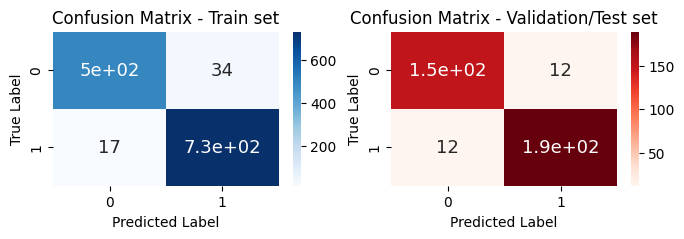

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

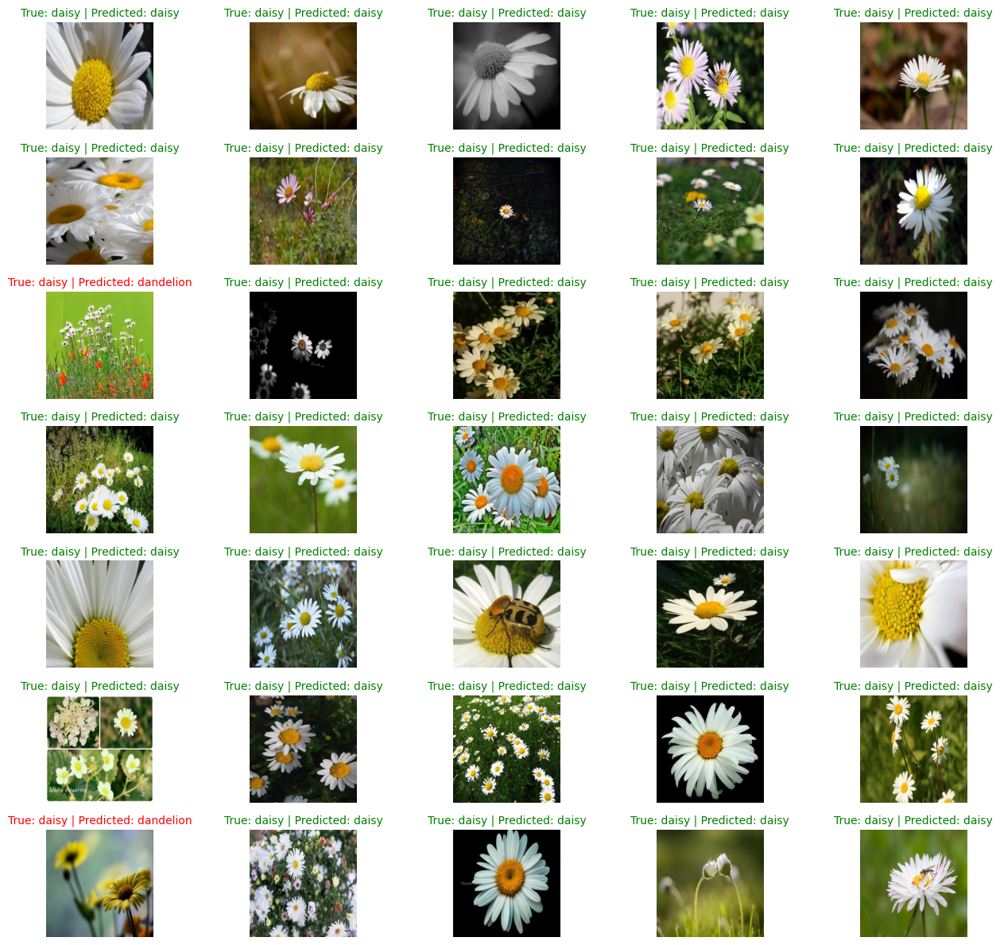

In [ ]:
show_predictions(my_efficientnet, loader = valid_loader, mean = MEAN_RGB, std = STD_RGB, int_to_labels = int_to_labels,
                     num_images = 35, num_columns = 5, size = (15, 12))

In [ ]:
sm = SaliencyMAP(my_efficientnet)

explain_predictions(sm, valid_loader, num_images = 20,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,6))

Output hidden; open in https://colab.research.google.com to view.

### ConvNeXt

  3%|▎         | 1/30 [00:05<02:51,  5.90s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 1
Train accuracy: 0.624  -------------- Valid accuracy: 0.857.
Train loss: 0.673  --------------   Valid loss: 0.628.


  7%|▋         | 2/30 [00:12<02:50,  6.08s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 2
Train accuracy: 0.855  -------------- Valid accuracy: 0.882.
Train loss: 0.598  --------------   Valid loss: 0.554.


 10%|█         | 3/30 [00:18<02:44,  6.11s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 3
Train accuracy: 0.889  -------------- Valid accuracy: 0.898.
Train loss: 0.536  --------------   Valid loss: 0.493.


 13%|█▎        | 4/30 [00:24<02:40,  6.16s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 4
Train accuracy: 0.893  -------------- Valid accuracy: 0.901.
Train loss: 0.485  --------------   Valid loss: 0.444.


 17%|█▋        | 5/30 [00:30<02:35,  6.21s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 5
Train accuracy: 0.908  -------------- Valid accuracy: 0.912.
Train loss: 0.445  --------------   Valid loss: 0.405.


 20%|██        | 6/30 [00:37<02:29,  6.23s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 6
Train accuracy: 0.912  -------------- Valid accuracy: 0.912.
Train loss: 0.412  --------------   Valid loss: 0.373.


 23%|██▎       | 7/30 [00:43<02:21,  6.16s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 7
Train accuracy: 0.911  -------------- Valid accuracy: 0.912.
Train loss: 0.382  --------------   Valid loss: 0.346.


 27%|██▋       | 8/30 [00:49<02:14,  6.09s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 8
Train accuracy: 0.922  -------------- Valid accuracy: 0.92.
Train loss: 0.354  --------------   Valid loss: 0.324.


 30%|███       | 9/30 [00:55<02:09,  6.17s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 9
Train accuracy: 0.918  -------------- Valid accuracy: 0.926.
Train loss: 0.341  --------------   Valid loss: 0.306.


 33%|███▎      | 10/30 [01:01<02:02,  6.14s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 10
Train accuracy: 0.923  -------------- Valid accuracy: 0.929.
Train loss: 0.322  --------------   Valid loss: 0.29.


 37%|███▋      | 11/30 [01:07<01:57,  6.17s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 11
Train accuracy: 0.915  -------------- Valid accuracy: 0.931.
Train loss: 0.311  --------------   Valid loss: 0.276.


 40%|████      | 12/30 [01:13<01:51,  6.18s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 12
Train accuracy: 0.923  -------------- Valid accuracy: 0.931.
Train loss: 0.295  --------------   Valid loss: 0.264.


 43%|████▎     | 13/30 [01:20<01:46,  6.28s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 13
Train accuracy: 0.933  -------------- Valid accuracy: 0.931.
Train loss: 0.282  --------------   Valid loss: 0.253.


 47%|████▋     | 14/30 [01:26<01:41,  6.34s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 14
Train accuracy: 0.929  -------------- Valid accuracy: 0.931.
Train loss: 0.272  --------------   Valid loss: 0.244.

 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 15
Train accuracy: 0.92  -------------- Valid accuracy: 0.934.
Train loss: 0.27  --------------   Valid loss: 0.236.


 53%|█████▎    | 16/30 [01:39<01:28,  6.33s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 16
Train accuracy: 0.927  -------------- Valid accuracy: 0.934.
Train loss: 0.259  --------------   Valid loss: 0.228.


 57%|█████▋    | 17/30 [01:45<01:22,  6.31s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 17
Train accuracy: 0.927  -------------- Valid accuracy: 0.934.
Train loss: 0.254  --------------   Valid loss: 0.222.


 60%|██████    | 18/30 [01:52<01:15,  6.31s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 18
Train accuracy: 0.933  -------------- Valid accuracy: 0.934.
Train loss: 0.24  --------------   Valid loss: 0.215.


 63%|██████▎   | 19/30 [01:58<01:09,  6.32s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 19
Train accuracy: 0.927  -------------- Valid accuracy: 0.934.
Train loss: 0.24  --------------   Valid loss: 0.21.


 67%|██████▋   | 20/30 [02:04<01:02,  6.26s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 20
Train accuracy: 0.937  -------------- Valid accuracy: 0.934.
Train loss: 0.23  --------------   Valid loss: 0.204.


 70%|███████   | 21/30 [02:10<00:56,  6.28s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 21
Train accuracy: 0.943  -------------- Valid accuracy: 0.934.
Train loss: 0.224  --------------   Valid loss: 0.199.


 73%|███████▎  | 22/30 [02:17<00:50,  6.27s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 22
Train accuracy: 0.942  -------------- Valid accuracy: 0.931.
Train loss: 0.219  --------------   Valid loss: 0.195.


 77%|███████▋  | 23/30 [02:23<00:43,  6.27s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 23
Train accuracy: 0.936  -------------- Valid accuracy: 0.937.
Train loss: 0.225  --------------   Valid loss: 0.191.


 80%|████████  | 24/30 [02:29<00:37,  6.23s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 24
Train accuracy: 0.938  -------------- Valid accuracy: 0.937.
Train loss: 0.213  --------------   Valid loss: 0.187.


 83%|████████▎ | 25/30 [02:35<00:31,  6.22s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 25
Train accuracy: 0.936  -------------- Valid accuracy: 0.934.
Train loss: 0.21  --------------   Valid loss: 0.184.

 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 26
Train accuracy: 0.93  -------------- Valid accuracy: 0.937.
Train loss: 0.21  --------------   Valid loss: 0.18.


 90%|█████████ | 27/30 [02:48<00:18,  6.19s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 27
Train accuracy: 0.943  -------------- Valid accuracy: 0.937.
Train loss: 0.196  --------------   Valid loss: 0.177.


 93%|█████████▎| 28/30 [02:54<00:12,  6.16s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 28
Train accuracy: 0.941  -------------- Valid accuracy: 0.937.
Train loss: 0.194  --------------   Valid loss: 0.174.


 97%|█████████▋| 29/30 [03:00<00:06,  6.25s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 29
Train accuracy: 0.948  -------------- Valid accuracy: 0.937.
Train loss: 0.192  --------------   Valid loss: 0.171.


100%|██████████| 30/30 [03:06<00:00,  6.23s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 30
Train accuracy: 0.936  -------------- Valid accuracy: 0.942.
Train loss: 0.197  --------------   Valid loss: 0.168.


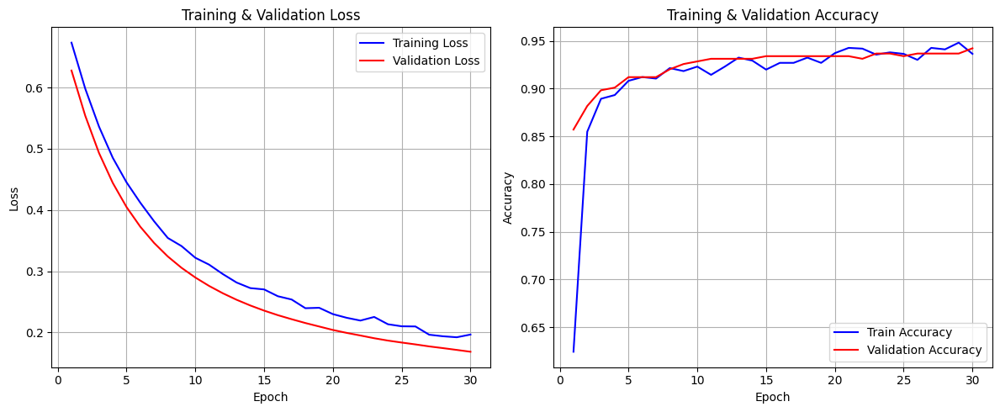

In [ ]:
my_convnext = BaselineModel(backbone = convnext_full.features,
                            N_f = N_f_convnext).to(device)

EPOCHS = 30

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_convnext.parameters(), lr = 0.0005)
early_stopping = EarlyStopping(path = './checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_convnext, loss_fn, optimizer,
                                      train_loader, valid_loader,
                                      epochs = EPOCHS, verbose = True,
                                      confusion_matrix_data = True,
                                      early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.946667,0.944921,0.946268,0.943701
Validation/Test,0.942308,0.941830,0.940901,0.943122


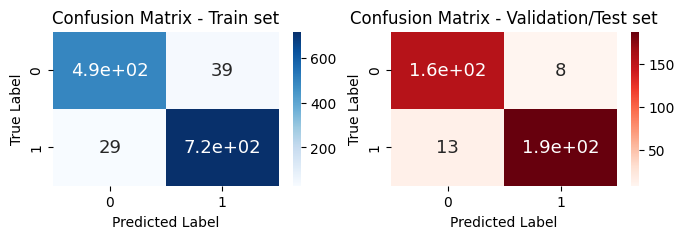

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

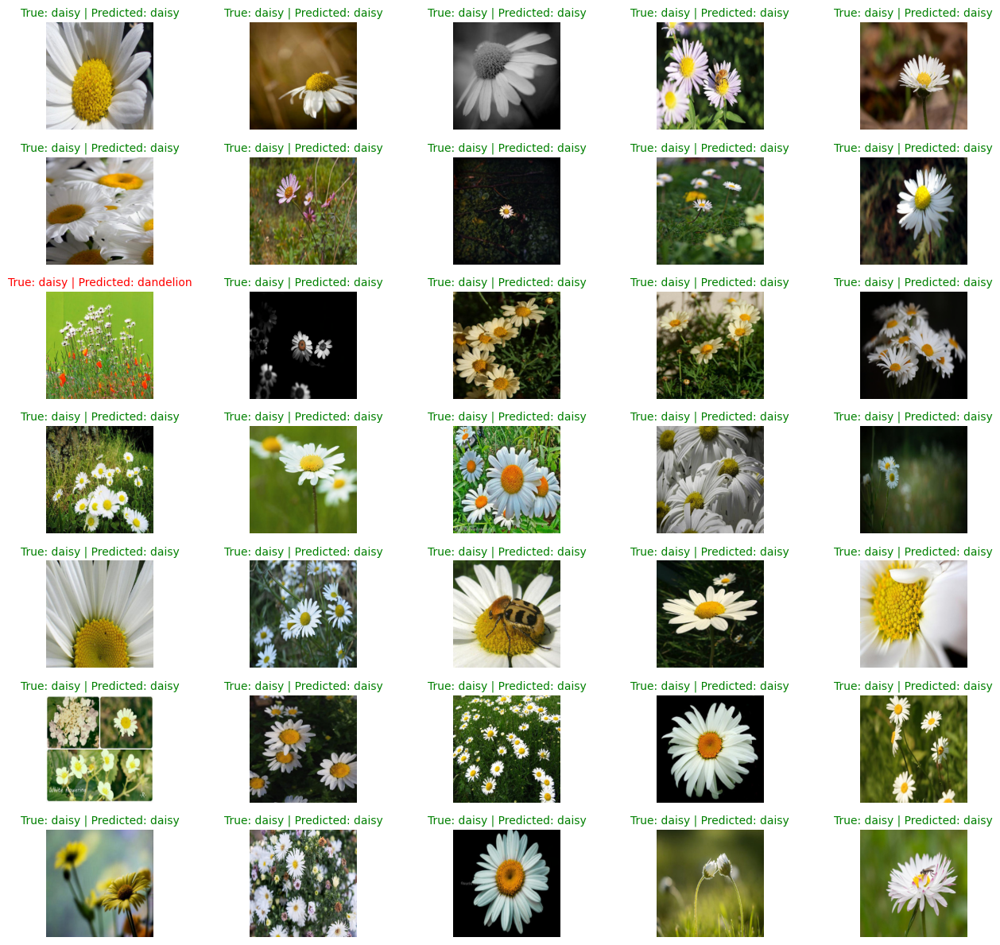

In [ ]:
show_predictions(my_convnext, loader = valid_loader, mean = MEAN_RGB, std = STD_RGB, int_to_labels = int_to_labels,
                     num_images = 35, num_columns = 5, size = (15, 12))

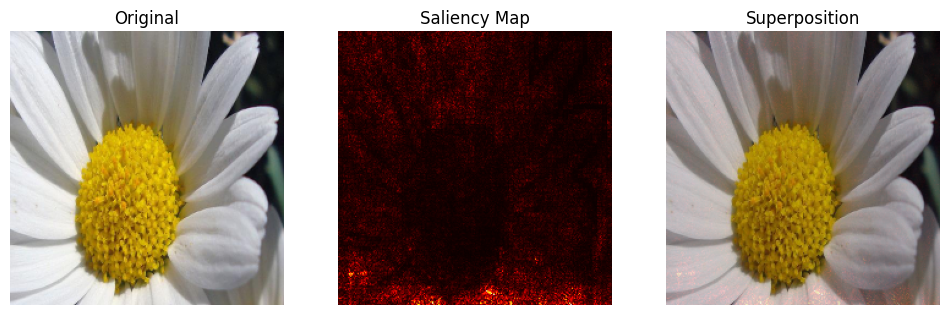

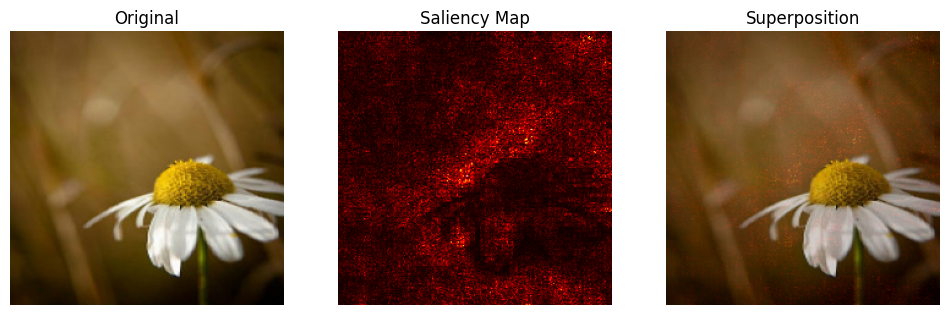

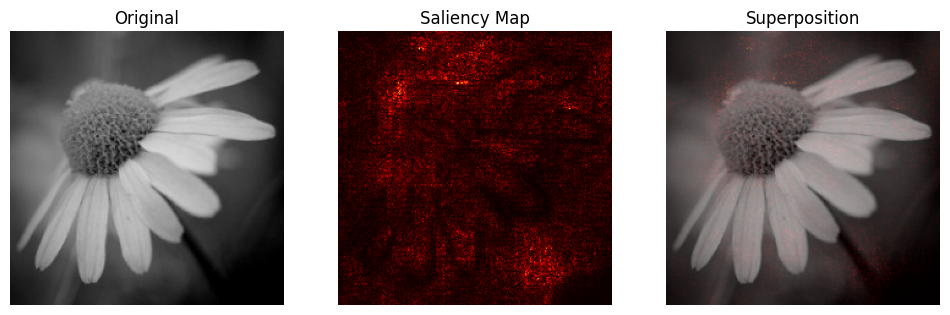

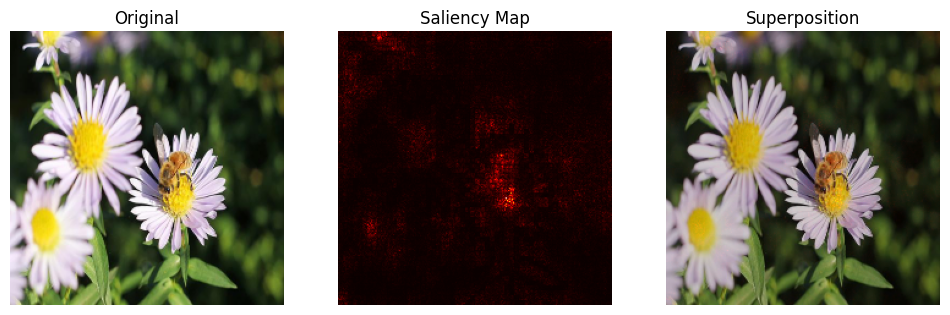

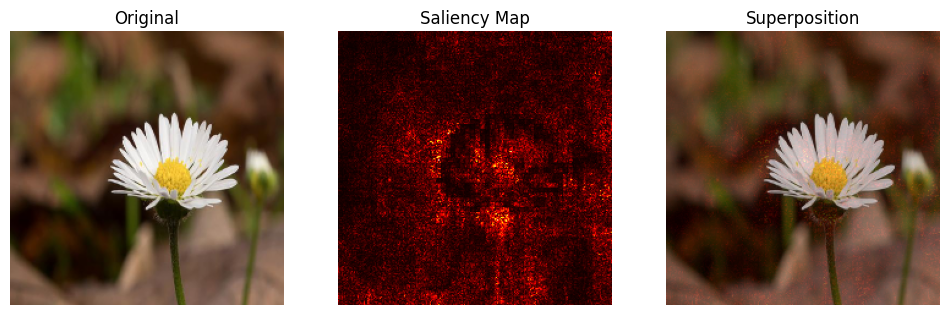

In [ ]:
sm = SaliencyMAP(my_convnext)

explain_predictions(sm, valid_loader, num_images = 5,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,6))

### VGG16

  3%|▎         | 1/30 [00:06<02:54,  6.01s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 1
Train accuracy: 0.715  -------------- Valid accuracy: 0.813.
Train loss: 0.615  --------------   Valid loss: 0.545.


  7%|▋         | 2/30 [00:12<02:48,  6.01s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 2
Train accuracy: 0.809  -------------- Valid accuracy: 0.832.
Train loss: 0.532  --------------   Valid loss: 0.478.


 10%|█         | 3/30 [00:18<02:46,  6.15s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 3
Train accuracy: 0.825  -------------- Valid accuracy: 0.868.
Train loss: 0.474  --------------   Valid loss: 0.43.


 13%|█▎        | 4/30 [00:24<02:37,  6.06s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 4
Train accuracy: 0.848  -------------- Valid accuracy: 0.882.
Train loss: 0.432  --------------   Valid loss: 0.395.


 17%|█▋        | 5/30 [00:30<02:30,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 5
Train accuracy: 0.855  -------------- Valid accuracy: 0.876.
Train loss: 0.397  --------------   Valid loss: 0.369.


 20%|██        | 6/30 [00:36<02:22,  5.94s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 6
Train accuracy: 0.871  -------------- Valid accuracy: 0.885.
Train loss: 0.372  --------------   Valid loss: 0.349.


 23%|██▎       | 7/30 [00:42<02:18,  6.01s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 7
Train accuracy: 0.867  -------------- Valid accuracy: 0.885.
Train loss: 0.357  --------------   Valid loss: 0.333.


 27%|██▋       | 8/30 [00:47<02:10,  5.93s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 8
Train accuracy: 0.879  -------------- Valid accuracy: 0.89.
Train loss: 0.335  --------------   Valid loss: 0.321.


 30%|███       | 9/30 [00:54<02:06,  6.04s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 9
Train accuracy: 0.884  -------------- Valid accuracy: 0.89.
Train loss: 0.32  --------------   Valid loss: 0.308.


 33%|███▎      | 10/30 [01:00<02:00,  6.04s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 10
Train accuracy: 0.9  -------------- Valid accuracy: 0.898.
Train loss: 0.306  --------------   Valid loss: 0.297.


 37%|███▋      | 11/30 [01:06<01:55,  6.07s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 11
Train accuracy: 0.898  -------------- Valid accuracy: 0.896.
Train loss: 0.296  --------------   Valid loss: 0.289.


 40%|████      | 12/30 [01:12<01:48,  6.02s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 12
Train accuracy: 0.897  -------------- Valid accuracy: 0.901.
Train loss: 0.291  --------------   Valid loss: 0.283.


 43%|████▎     | 13/30 [01:18<01:41,  5.99s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 13
Train accuracy: 0.908  -------------- Valid accuracy: 0.901.
Train loss: 0.278  --------------   Valid loss: 0.274.


 47%|████▋     | 14/30 [01:24<01:35,  5.98s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 14
Train accuracy: 0.899  -------------- Valid accuracy: 0.907.
Train loss: 0.271  --------------   Valid loss: 0.267.


 50%|█████     | 15/30 [01:30<01:30,  6.04s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 15
Train accuracy: 0.913  -------------- Valid accuracy: 0.904.
Train loss: 0.265  --------------   Valid loss: 0.263.


 53%|█████▎    | 16/30 [01:36<01:23,  5.97s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 16
Train accuracy: 0.906  -------------- Valid accuracy: 0.909.
Train loss: 0.264  --------------   Valid loss: 0.257.


 57%|█████▋    | 17/30 [01:42<01:18,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 17
Train accuracy: 0.909  -------------- Valid accuracy: 0.918.
Train loss: 0.254  --------------   Valid loss: 0.251.


 60%|██████    | 18/30 [01:48<01:11,  5.95s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 18
Train accuracy: 0.911  -------------- Valid accuracy: 0.915.
Train loss: 0.249  --------------   Valid loss: 0.248.


 63%|██████▎   | 19/30 [01:54<01:06,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 19
Train accuracy: 0.915  -------------- Valid accuracy: 0.918.
Train loss: 0.247  --------------   Valid loss: 0.244.


 67%|██████▋   | 20/30 [02:00<00:59,  5.98s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 20
Train accuracy: 0.919  -------------- Valid accuracy: 0.923.
Train loss: 0.239  --------------   Valid loss: 0.239.


 70%|███████   | 21/30 [02:06<00:54,  6.02s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 21
Train accuracy: 0.918  -------------- Valid accuracy: 0.92.
Train loss: 0.239  --------------   Valid loss: 0.237.


 73%|███████▎  | 22/30 [02:12<00:48,  6.07s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 22
Train accuracy: 0.92  -------------- Valid accuracy: 0.923.
Train loss: 0.233  --------------   Valid loss: 0.233.


 77%|███████▋  | 23/30 [02:18<00:42,  6.07s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 23
Train accuracy: 0.917  -------------- Valid accuracy: 0.923.
Train loss: 0.229  --------------   Valid loss: 0.231.


 80%|████████  | 24/30 [02:24<00:36,  6.01s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 24
Train accuracy: 0.922  -------------- Valid accuracy: 0.923.
Train loss: 0.226  --------------   Valid loss: 0.227.


 83%|████████▎ | 25/30 [02:30<00:30,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 25
Train accuracy: 0.922  -------------- Valid accuracy: 0.923.
Train loss: 0.225  --------------   Valid loss: 0.224.


 87%|████████▋ | 26/30 [02:36<00:24,  6.02s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 26
Train accuracy: 0.923  -------------- Valid accuracy: 0.923.
Train loss: 0.22  --------------   Valid loss: 0.221.


 90%|█████████ | 27/30 [02:42<00:17,  5.98s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 27
Train accuracy: 0.923  -------------- Valid accuracy: 0.923.
Train loss: 0.217  --------------   Valid loss: 0.22.


 93%|█████████▎| 28/30 [02:48<00:12,  6.03s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 28
Train accuracy: 0.925  -------------- Valid accuracy: 0.923.
Train loss: 0.217  --------------   Valid loss: 0.217.


 97%|█████████▋| 29/30 [02:54<00:06,  6.04s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 29
Train accuracy: 0.926  -------------- Valid accuracy: 0.923.
Train loss: 0.205  --------------   Valid loss: 0.216.


100%|██████████| 30/30 [03:00<00:00,  6.02s/it]


 ----------------------------------------------------------------------------------------------------------------------------------------------------------------
									 AT EPOCH 30
Train accuracy: 0.93  -------------- Valid accuracy: 0.923.
Train loss: 0.206  --------------   Valid loss: 0.213.


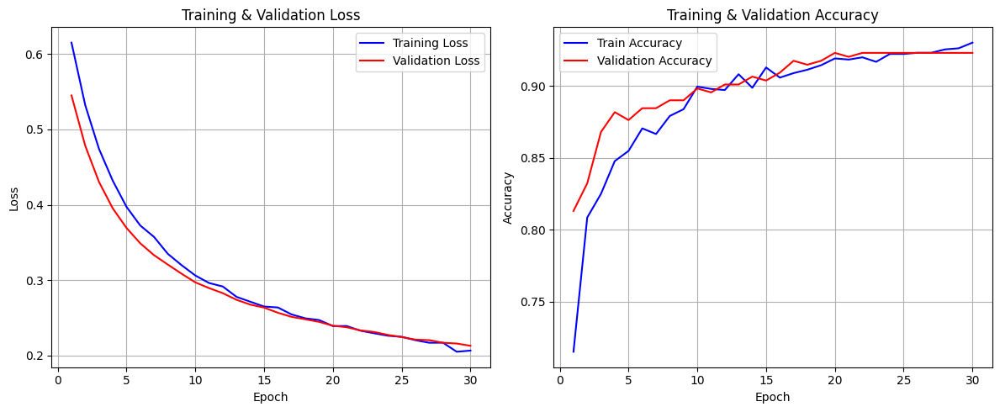

In [ ]:
my_vgg16 = BaselineModel(backbone = vgg16_full.features,
                         N_f = N_f_vgg16).to(device)

EPOCHS = 30

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_vgg16.parameters(), lr = 0.0005)
early_stopping = EarlyStopping(path = './checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_vgg16, loss_fn, optimizer,
                                      train_loader, valid_loader,
                                      epochs = EPOCHS, verbose = True,
                                      confusion_matrix_data = True,
                                      early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.931765,0.928945,0.935002,0.924643
Validation/Test,0.923077,0.921936,0.923905,0.920490


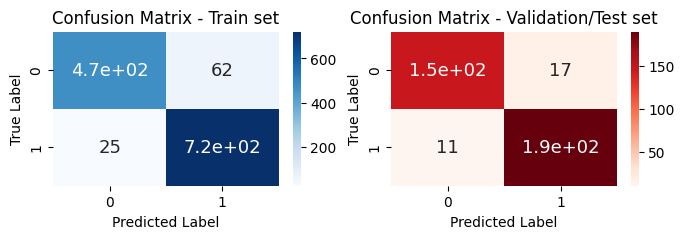

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

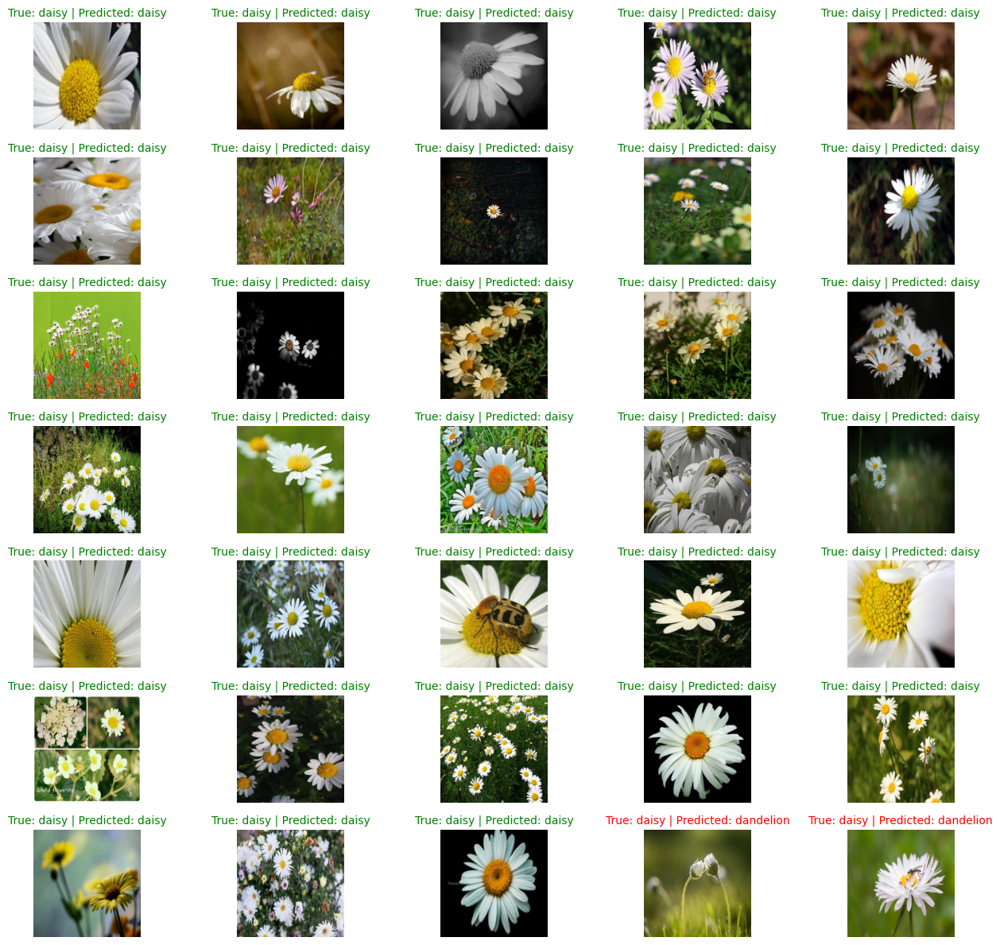

In [ ]:
show_predictions(my_vgg16, loader = valid_loader, mean = MEAN_RGB, std = STD_RGB, int_to_labels = int_to_labels,
                     num_images = 35, num_columns = 5, size = (15, 12))

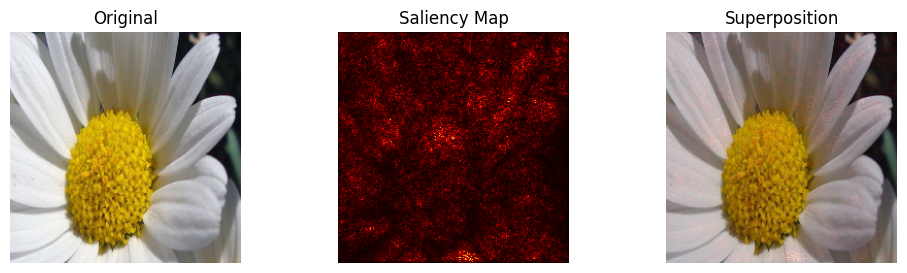

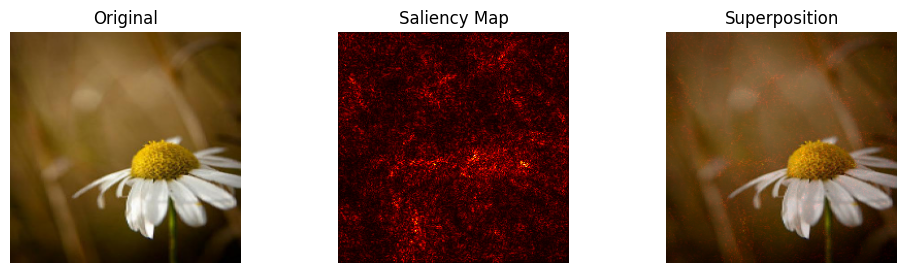

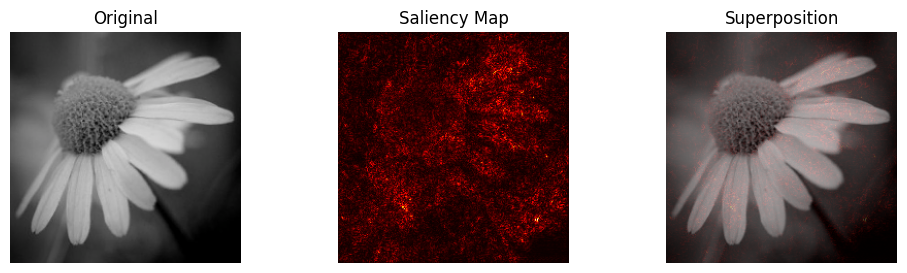

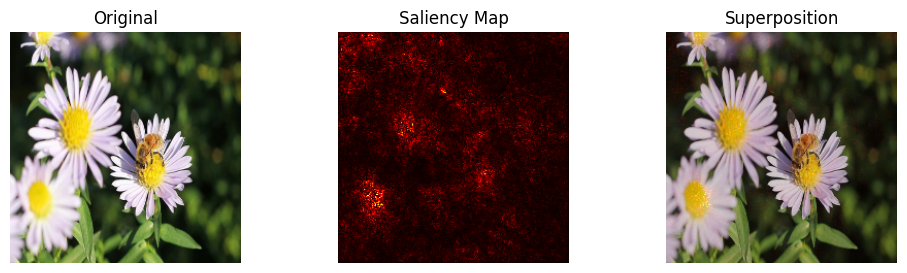

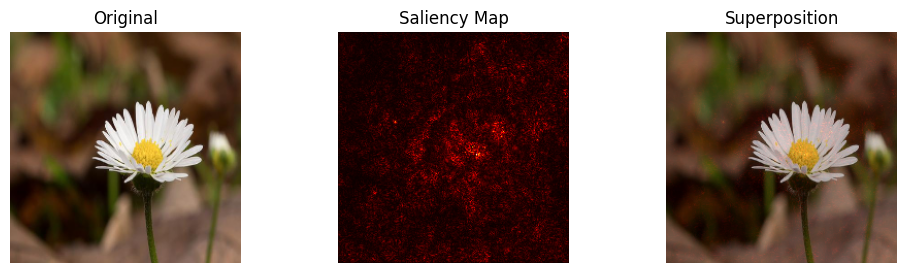

In [ ]:
sm = SaliencyMAP(my_vgg16)

explain_predictions(sm, valid_loader, num_images = 5,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,3))

## Improving performances

D'ora in poi verra' utilizzato ConvNeXt perche' fra i tre e' quello che overfitta meno, raggiunge F1-score piu' alti, e dall'analisi delle saliency maps sembra quello che si focalizza meglio sulle features rilevanti. Possiamo quindi provare ad usare una testa di classificazione piu' complicata:

In [ ]:
class EnlargedModel(nn.Module):
  """
    backbone: a nn.Module, which extracts the features;
    N_f: the number of feature maps in output of the backbone
    """
  def __init__(self, backbone: nn.Module, N_f):
    super().__init__()
    self.features = backbone
    self.N_f = N_f
    self.classification_head = nn.Sequential(
        nn.AdaptiveAvgPool2d((1, 1)), # X.shape: [B, N_f, 1, 1]
        nn.Flatten(), # X.shape: [B, N_f]
        nn.Linear(self.N_f, 100),
        nn.BatchNorm1d(100),
        nn.ReLU(),
        nn.Dropout(),
        nn.Linear(100, 50),
        nn.BatchNorm1d(50),
        nn.ReLU(),
        nn.Dropout(),
        nn.Linear(50, 2)) # X.shape: [B, 2]

  def forward(self, X): # X.shape: [B, C = 3, RESIZE_DIM, RESIZE_DIM]
    X = self.features(X)  # X.shape: [B, N_f, ..., ...]
    X = self.classification_head(X) # X.shape: [B, 2]
    return X

100%|██████████| 50/50 [05:12<00:00,  6.24s/it]


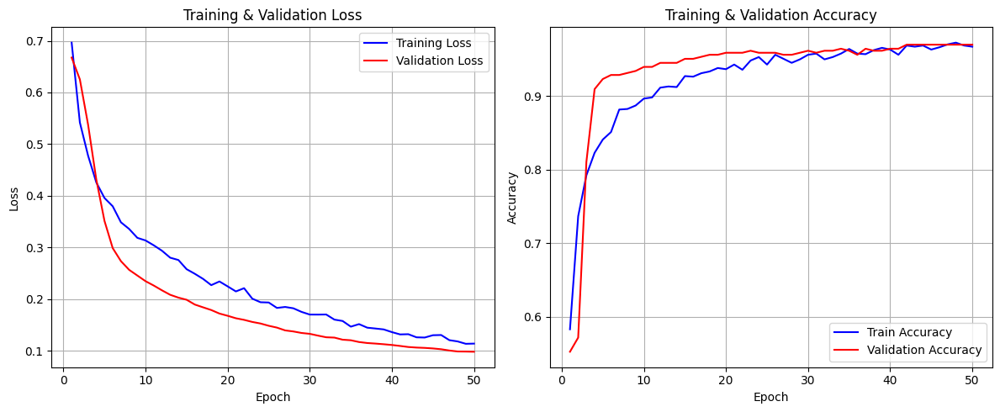

In [ ]:
my_convnext = EnlargedModel(backbone = convnext_full.features,
                                N_f = N_f_convnext).to(device)

EPOCHS = 50

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = my_convnext.parameters(), lr = 0.0001)
early_stopping = EarlyStopping(path = './enlarged_checkpoint.pt')

[train_losses, train_accuracies, val_losses, val_accuracies], [y_train, yhat_train, y_val, yhat_val] = \
                train_classification(my_convnext, loss_fn, optimizer,
                                     train_loader, valid_loader,
                                     epochs = EPOCHS, verbose = False,
                                     confusion_matrix_data = True,
                                     early_stopping = early_stopping)

training_results(train_losses, train_accuracies, val_losses, val_accuracies, size = (12, 5))

,Accuracy,F1-score,Precision,Recall
Train,0.970196,0.969203,0.970937,0.967657
Validation/Test,0.958791,0.958450,0.957483,0.959787


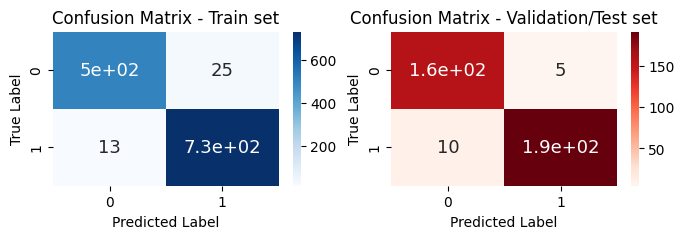

In [ ]:
metrics_train, metrics_val, metrics_df, confusion_matrices = metrics_report(y_train, yhat_train, y_val, yhat_val,
                                                                            verbose = True, size = (8, 2))

In [ ]:
sm = SaliencyMAP(my_convnext)

explain_predictions(sm, valid_loader, num_images = 30,
                       cmap = 'hot', transparency = 0.2,
                       mean = MEAN_RGB, std = STD_RGB, size = (12,6))

Output hidden; open in https://colab.research.google.com to view.

## Final test and discussion

Avendo identificato il miglior modello possiamo procedere verso il test finale, usando finalmente il test set:

In [ ]:
test_dataset = torchvision.datasets.ImageFolder(test_path,
                                                 transform = Transforms(baseline_transforms))
test_loader = data_utils.DataLoader(test_dataset, batch_size = 128, shuffle = False, num_workers = 2, pin_memory = True)

,Accuracy,F1-score,Precision,Recall
Test,0.956044,0.954816,0.956636,0.953247


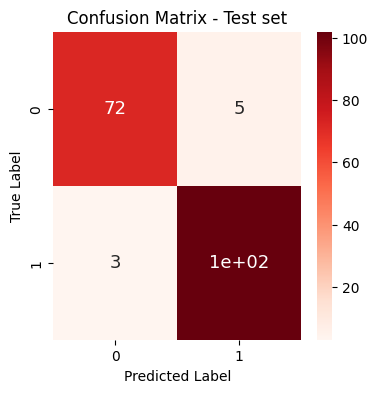

In [ ]:
metrics_test, metrics_df, cm_test = test_model(my_convnext, loss_fn, test_loader, verbose = True)

In definitiva, abbiamo provato diversi modelli con diversi iperparametri, regolarizzazioni e architetture. Alla fine abbiamo definito un modello che overfitta molto poco, che sul test set si comporta come si comporta sul set di validation, e che ha un'accuracy, precision, recall e sopratutto F1-score soddisfacente. Per migliorare ulteriormente il modello, possiamo osservare che il dataset di training e' sbilanciato verso la classe 1 (maggiormente popolata), ed infatti sul set di train ci sono molti falsi del tipo $(y=1, \hat{y}=0)$. Per questo sarebbe utile raccogliere piu' dati appartenenti alla classe 0. Inoltre sarebbe molto interessante sbloccare i pesi di qualche layer della CNN e fare un vero fine-tuning (con un learning rate molto basso, per non fare catastrphic forgetting), ma sarebbe stato troppo lungo per questo progetto.

Salviamo i parametri per eventuale future analisi:

In [ ]:
torch.save({
    'model_state_dict': my_convnext.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'lr': optimizer.param_groups[0]['lr'],
}, "best_weights.pt")